# 增强ALPHA
### 载入必要库
## 构建数据Pipeline
在线平台性能上很难满足大规模调试策略，加上机器学习或深度学习等计算密集型模型，所以本地回测如何提高效率是第一待解决的问题。
而zipline中的pipeline机制是很高效的。
### Bundle的注册
因为此项目我们用Zipline来处理数据，1.2章节中我们创建了数据Bundle。
此处我们需要注册创建的Bundle方便Zipline调用数据。
### 创建Pipeline引擎
我们将运用Pipeline包来处理股票数据。此前，我们需要创建Pipeline引擎，方便之后使用。
#### 查看数据
创建Pipeline引擎后，查看股票池最后一天的股票列表。

In [22]:
import sys
import project_helper
import project_tests

import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt

%matplotlib inline
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (14, 8)

import sys
import os
from zipline.data import bundles

os.environ['ZIPLINE_ROOT'] = os.path.join('C:/Users/ltjsu/.zipline')

ingest_func = bundles.csvdir.csvdir_equities(['daily'], 'custom-csvdir-bundle')
bundles.register('custom-csvdir-bundle', ingest_func)

from zipline.pipeline import Pipeline
from zipline.pipeline.factors import AverageDollarVolume
from zipline.utils.calendars import get_calendar

# universe = AverageDollarVolume(window_length=120).top(500) 
trading_calendar = get_calendar('XSHG')
bundle_data = bundles.load('custom-csvdir-bundle')
engine = project_helper.build_pipeline_engine(bundle_data, trading_calendar)

C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\ipykernel_launcher.py:21: UserWarning: Overwriting bundle with name 'custom-csvdir-bundle'


简单处理股票列表信息，方便获取申万行业数据。
### 获取收益率
构建DataPortal获取个股收益率数据。

自定义函数`get_pricing`获取股票收益率，增加代码可读性。

In [23]:
from zipline.data.data_portal import DataPortal
data_portal = DataPortal(
    bundle_data.asset_finder,
    trading_calendar=trading_calendar,
    first_trading_day=bundle_data.equity_daily_bar_reader.first_trading_day,
    equity_minute_reader=None,
    equity_daily_reader=bundle_data.equity_daily_bar_reader,
    adjustment_reader=bundle_data.adjustment_reader)

def get_pricing(data_portal, trading_calendar, assets, start_date, end_date, field='close'):
    end_dt = pd.Timestamp(end_date.strftime('%Y-%m-%d'), tz='UTC', offset='C')
    start_dt = pd.Timestamp(start_date.strftime('%Y-%m-%d'), tz='UTC', offset='C')

    end_loc = trading_calendar.closes.index.get_loc(end_dt)
    start_loc = trading_calendar.closes.index.get_loc(start_dt)

    return data_portal.get_history_window(
        assets=assets,
        end_dt=end_dt,
        bar_count=end_loc - start_loc,
        frequency='1d',
        field=field,
        data_frequency='daily')

# Alpha因子
定义Alpha因子。此项目主要关注以下因子：
- 动量因子_1年
- 行业中性均值回归_5日平滑因子
- 隔夜情绪平滑因子

**此处务必保证，factor_start_date不能是周末和节假日，不然后面会报错**

### 往Pipeline中添加因子
将以上因子添加到Pipeline中。

## 特征工程
定义一些对模型预测有帮助的特征。 好的基础特征能够作为显著的条件因子，对模型最终的预测有帮助。
### 一些”通用“量化特征
为了体现通用性，我们运用一下基础特征：
- 股票波动 20日平滑, 120日平滑
- 成交量量 20日平滑, 120日平滑
- 行业

### 市场特征
Regime Features
为了抓取市场特性，我们运用一下特征：
- 市场波动 20日平滑, 120日平滑
- 市场分散（离差） 20日平滑, 120日平滑

### 标签--预测目标
此项目对未来一周的收益做预测。因此量化目标过程中，因子追踪五日收益率。

### 日期特征
因为日历异象（calendar anomalies）的存在，此处定义一些日期相关的特征。

In [24]:
from zipline.pipeline.factors import CustomFactor, DailyReturns, Returns, SimpleMovingAverage, AnnualizedVolatility
from zipline.pipeline.data import USEquityPricing

universe_end_date = pd.Timestamp('2020-10-27', tz='UTC')
# 2020-09-28； 2020-08-28； 2020-07-28；2020-06-27；2020-05-28 
factor_start_date = universe_end_date - pd.DateOffset(years=5, days=4)
print(factor_start_date)
universe = AverageDollarVolume(window_length=120).top(500)
sector = project_helper.Sector()

def momentum_1yr(window_length, universe, sector):
    return Returns(window_length=window_length, mask=universe) \
        .demean(groupby=sector) \
        .rank() \
        .zscore()

def mean_reversion_5day_sector_neutral_smoothed(window_length, universe, sector):
    unsmoothed_factor = -Returns(window_length=window_length, mask=universe) \
        .demean(groupby=sector) \
        .rank() \
        .zscore()
    return SimpleMovingAverage(inputs=[unsmoothed_factor], window_length=window_length) \
        .rank() \
        .zscore()

class CTO(Returns):
    """
    Computes the overnight return, per hypothesis from
    https://papers.ssrn.com/sol3/papers.cfm?abstract_id=2554010
    """
    inputs = [USEquityPricing.open, USEquityPricing.close]
    
    def compute(self, today, assets, out, opens, closes):
        """
        The opens and closes matrix is 2 rows x N assets, with the most recent at the bottom.
        As such, opens[-1] is the most recent open, and closes[0] is the earlier close
        """
        out[:] = (opens[-1] - closes[0]) / closes[0]
        
class TrailingOvernightReturns(Returns):
    """
    Sum of trailing 1m O/N returns
    """
    window_safe = True
    
    def compute(self, today, asset_ids, out, cto):
        out[:] = np.nansum(cto, axis=0)

def overnight_sentiment_smoothed(cto_window_length, trail_overnight_returns_window_length, universe):
    cto_out = CTO(mask=universe, window_length=cto_window_length)
    unsmoothed_factor = TrailingOvernightReturns(inputs=[cto_out], window_length=trail_overnight_returns_window_length) \
        .rank() \
        .zscore()
    return SimpleMovingAverage(inputs=[unsmoothed_factor], window_length=trail_overnight_returns_window_length) \
        .rank() \
        .zscore()
        
class MarketDispersion(CustomFactor):
    inputs = [DailyReturns()]
    window_length = 1
    window_safe = True

    def compute(self, today, assets, out, returns):
        # returns are days in rows, assets across columns
        out[:] = np.sqrt(np.nanmean((returns - np.nanmean(returns))**2))
        
class MarketVolatility(CustomFactor):
    inputs = [DailyReturns()]
    window_length = 1
    window_safe = True
    
    def compute(self, today, assets, out, returns):
        mkt_returns = np.nanmean(returns, axis=1)
        out[:] = np.sqrt(260.* np.nanmean((mkt_returns-np.nanmean(mkt_returns))**2))
        

pipeline = Pipeline(screen=universe)
pipeline.add(momentum_1yr(252, universe, sector),'Momentum_1YR')
pipeline.add(mean_reversion_5day_sector_neutral_smoothed(20, universe, sector),'Mean_Reversion_Sector_Neutral_Smoothed')
pipeline.add(overnight_sentiment_smoothed(2, 10, universe),'Overnight_Sentiment_Smoothed')
pipeline.add(AnnualizedVolatility(window_length=20, mask=universe).rank().zscore(), 'volatility_20d')
pipeline.add(AnnualizedVolatility(window_length=120, mask=universe).rank().zscore(), 'volatility_120d')
pipeline.add(AverageDollarVolume(window_length=20, mask=universe).rank().zscore(), 'adv_20d')
pipeline.add(AverageDollarVolume(window_length=120, mask=universe).rank().zscore(), 'adv_120d')
pipeline.add(sector, 'sector_code')
pipeline.add(SimpleMovingAverage(inputs=[MarketDispersion(mask=universe)], window_length=20), 'dispersion_20d')
pipeline.add(SimpleMovingAverage(inputs=[MarketDispersion(mask=universe)], window_length=120), 'dispersion_120d')
pipeline.add(MarketVolatility(window_length=20), 'market_vol_20d')
pipeline.add(MarketVolatility(window_length=120), 'market_vol_120d')
# pipeline.add(Returns(window_length=5, mask=universe).quantiles(2), 'return_5d')
# pipeline.add(Returns(window_length=5, mask=universe).quantiles(25), 'return_5d_p')
pipeline.add(Returns(window_length=10, mask=universe).quantiles(2), 'return_10d')
# pipeline.add(Returns(window_length=10, mask=universe).quantiles(25), 'return_10d_p')

all_factors = engine.run_pipeline(pipeline, factor_start_date, universe_end_date)
all_factors['is_Janaury'] = all_factors.index.get_level_values(0).month == 1
all_factors['is_December'] = all_factors.index.get_level_values(0).month == 12
all_factors['weekday'] = all_factors.index.get_level_values(0).weekday
all_factors['quarter'] = all_factors.index.get_level_values(0).quarter
all_factors['qtr_yr'] = all_factors.quarter.astype('str') + '_' + all_factors.index.get_level_values(0).year.astype('str')
all_factors['month_end'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BM'))
all_factors['month_start'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BMS'))
all_factors['qtr_end'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BQ'))
all_factors['qtr_start'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BQS'))

2015-10-23 00:00:00+00:00


去处5_10日回报中的异常数据。
### 行业信息独热编码
独热编码有助于模型更好的理解行业信息。

### 日期平移
每日收益率往前平移5/10日（一/两周），作为模型目标。
### 目标独立相似分布（IID）检测
查看平移不同时长的收益率之间是否是独立同分布。
**斯皮尔曼相关度计算**

In [25]:
from scipy.stats import spearmanr

def sp(group, col1_name, col2_name):
    x = group[col1_name]
    y = group[col2_name]
    return spearmanr(x, y)[0]

# all_factors['return_5d'].replace(to_replace=-1, value=np.nan, inplace=True)
all_factors['return_10d'].replace(to_replace=-1, value=np.nan, inplace=True)

sector_lookup = pd.read_csv(
    os.path.join(os.getcwd(), 'data', 'project_7_sector', 'labels.csv'),
    index_col='Sector_i')['Sector'].to_dict()
sector_lookup

sector_columns = []
for sector_i, sector_name in sector_lookup.items():
    secotr_column = '{}行业'.format(sector_name)
    sector_columns.append(secotr_column)
    all_factors[secotr_column] = (all_factors['sector_code'] == sector_i)

# all_factors['target_5D'] = all_factors.groupby(level=1)['return_5d'].shift(-5)
all_factors['target_10D'] = all_factors.groupby(level=1)['return_10d'].shift(-10)

### 标签平移对于自相关的影响
从上图中可以观察到：

$ 自相关{Target1} > 自相关{Target2} > 自相关{Target3} > 自相关{Target4}$

自相关随着增加两次收益之间的间隔而减小。 自相关在正范围内，这意味着未来收益趋向于与过去收益相同的方向。此外，滞后1的自相关约在0.5附件振荡，滞后4的自相关约在0附近振荡，因此序列相关的程度从中等到非常低

这与股票收益通常表现出序列相关性是一致的

### 拆分训练集/验证集/测试集
将数据分为训练，验证和测试数据集。 实现函数“ train_valid_test_split”将输入样本“ all_x”和目标值“ all_y”分割为训练，验证和测试数据集。 比例大小分别是“ train_size”，“ valid_size”和“ test_size”。

分割时，请确保数据分别来自训练，验证和测试的顺序。 假设“ train_size”为0.7，“ valid_size”为0.2，而“ test_size”为0.1。 all_x和all_y的前70％是训练集合。 接下来的all_x和all_y 20％将是验证集。 all_x和all_y的最后10％是测试集。 确保不要将同一天分配给多个数据集，它应包含在单个数据集中。

得到`train_valid_test_split`之后，就可以将数据拆分成训练集、验证集和测试集。
选取如下特征和5日收益率为预测目标。

In [26]:
def train_valid_test_split(all_x, all_y, train_size, valid_size, test_size):
    """
    Generate the train, validation, and test dataset.
    """
    assert train_size >= 0 and train_size <= 1.0
    assert valid_size >= 0 and valid_size <= 1.0
    assert test_size >= 0 and test_size <= 1.0
    assert train_size + valid_size + test_size == 1.0
    
    # TODO: Implement
    train_inx = int(len(all_x) * train_size)
    valid_ind = int(len(all_x) * (train_size + valid_size))
    x_train = all_x[:train_inx]
    x_valid = all_x[train_inx:valid_ind]
    x_test  = all_x[valid_ind:]
    y_train = all_y[:train_inx]
    y_valid = all_y[train_inx:valid_ind]
    y_test  = all_y[valid_ind:]
    
    return x_train, x_valid, x_test, y_train, y_valid, y_test

project_tests.test_train_valid_test_split(train_valid_test_split)

features = [
    'Mean_Reversion_Sector_Neutral_Smoothed', 'Momentum_1YR',
    'Overnight_Sentiment_Smoothed', 'adv_120d', 'adv_20d',
    'dispersion_120d', 'dispersion_20d', 'market_vol_120d',
    'market_vol_20d', 'volatility_20d',
    'is_Janaury', 'is_December', 'weekday',
    'month_end', 'month_start', 'qtr_end', 'qtr_start'] + sector_columns
target_label = 'target_10D'
# target_5D

temp = all_factors.dropna().copy()
X = temp[features]
y = temp[target_label].astype(int)

X_train, X_valid, X_test, y_train, y_valid, y_test = train_valid_test_split(X, y, 0.8, 0.1, 0.1)

Tests Passed


In [27]:
y_train.value_counts()

1    194239
0    191644
Name: target_10D, dtype: int64

# 集成学习
## 随即森林
### 决策树
单个决策树决策效果展示。

**对标的日期不做区分，使得此模型对股票种类不敏感，时序信息也丢失较多**

**对单一标定分别进行训练，将学习出属于不同标的的特性。高频数据将解决数据不够的问题**

### 随机森林超参数 -- 决策树数量
定义不同参数，来确定最好的模型。
#### 参数
参见以下参数

##### min_samples_leaf
min_samples_leaf ： 决策树每个叶--也就是决策树最底层样本数量。 足够小，有助于模型抓住数据细节；过于小，模型容易过拟合。
此参数的值以股票池股票数量的倍数为宜。当夏普率大于4的时候，往往是过拟合的征兆，因此建议设置为10倍股票数量。

次倍数可以调节，但过度调试也会在验证集上过拟合，从而降低模型泛化性，样本外数据表现很差。 因此倍数以指数的形式变动（10倍，20倍，100倍，而不是10倍11倍12倍...）。

##### n_trees_l
参考下图，分类器准确率随着决策树数量的变化。

#### 判定过/欠拟合

- 图中验本外数据比验证集准确率高；决策树数量较少时，训练和样本外集准确率随着决策树增加而增加，而验证集下降，决策树数量较多时，准确率不在变化。
- 准确率的差值可以用来判定过/欠拟合（差距较大--过拟合；差距小--欠拟合）

下标展示，各特征的特征重要度在众多决策树上的均值。

In [28]:
from IPython.display import display
from sklearn.tree import DecisionTreeClassifier

# This is to get consistent results between each run.
clf_random_state = 0
MAX_DEPTH = 4
n_days = 10
n_stocks = 500

clf_parameters = {
    'criterion': 'entropy',
    'min_samples_leaf': n_stocks * n_days,
    'oob_score': True,
    'n_jobs': -1,
    'random_state': clf_random_state}
n_trees_l = [10, 20, 50, 100, 250]

from sklearn.ensemble import RandomForestClassifier

上表中有些特征的特征重要度是0，之后的模型训练不在用这些特征。
### 模型结果
一下而外的指标讲用于衡量模型的预测能力。函数 `show_sample_results` 用来计算如下指标：
- 夏普率
- 因子回报率
- 因子自相关系数排序

**此处是用alphalens，评估模型性能，并不考虑交易成本**

#### 预测效果
用一下几个因子与增强因子做个比较：

##### 训练
模型在训练集上训练。

In [29]:
import alphalens as al

all_assets = all_factors.index.levels[1].values.tolist()
all_pricing = get_pricing(
    data_portal,
    trading_calendar,
    all_assets,
    factor_start_date,
    universe_end_date)

def get_IC(factor_data):
    ls_IC = pd.DataFrame()
    
    for factor, factor_data in factor_data.items():
        ls_IC[factor] = al.performance.factor_information_coefficient(factor_data).iloc[:,0]
        print(factor)
        al.tears.create_full_tear_sheet(factor_data)
        
    return ls_IC

def show_sample_results(data, samples, classifier, factors, pricing=all_pricing,max_loss=0.35):
    # Calculate the Alpha Score
    prob_array=[-1,1]
    print(classifier.predict_proba(samples)[0])
    alpha_score = classifier.predict_proba(samples).dot(np.array(prob_array))
    
    # Add Alpha Score to rest of the factors
    alpha_score_label = '增强_ALPHA'
    factors_with_alpha = data.loc[samples.index].copy()
    factors_with_alpha[alpha_score_label] = alpha_score
    
    # Setup data for AlphaLens
    print('Cleaning Data...\n')
    factor_data = project_helper.build_factor_data(factors_with_alpha[factors + [alpha_score_label]], 
                                                   pricing,max_loss=max_loss,periods = (1,10))
    print('\n-----------------------\n')
    
    # Calculate Factor Returns and Sharpe Ratio
    factor_returns = project_helper.get_factor_returns(factor_data)
    sharpe_ratio = project_helper.sharpe_ratio(factor_returns)
    
    # Show Results
    print('             Sharpe Ratios')
    print(sharpe_ratio.round(2))
    project_helper.plot_factor_returns(factor_returns)
    project_helper.plot_factor_rank_autocorrelation(factor_data)
    
    factor_IC = get_IC(factor_data)
    print(factor_IC.mean())
    return factor_IC
    
factor_names = [
    'Mean_Reversion_Sector_Neutral_Smoothed',
    'Momentum_1YR',
    'Overnight_Sentiment_Smoothed',
    'adv_120d',
    'volatility_20d',
    'adv_20d']

C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\ipykernel_launcher.py:11: FutureWarning: offset is deprecated. Use freq instead
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\ipykernel_launcher.py:12: FutureWarning: offset is deprecated. Use freq instead
  if sys.path[0] == '':


标签是五日回报，相邻的两个标签有4日是重叠的，导致标签之间自相关性较强。
此处消除标签的自相关性，降低过拟合的可能性。

## 样本重叠
通过yi
Let's fix this by removing overlapping samples. We can do a number of things:

- Don't use overlapping samples
- Use BaggingClassifier's `max_samples`
- Build an ensemble of non-overlapping trees

In this project, we'll do all three methods and compare.
### Drop Overlapping Samples
This is the simplest of the three methods. We'll just drop any overlapping samples from the dataset. Implement the `non_overlapping_samples` function to return a new dataset overlapping samples. 

In [30]:
def non_overlapping_samples(x, y, n_skip_samples, start_i=0):
    """
    Get the non overlapping samples.

    """
    assert len(x.shape) == 2
    assert len(y.shape) == 1
    
    # TODO: Implement
    subsampled_idx = x.index.levels[0].tolist()[start_i :: n_skip_samples + 1]
    non_overlapping_x = x.loc[subsampled_idx]
    non_overlapping_y = y.loc[subsampled_idx]
    
    return non_overlapping_x, non_overlapping_y

# project_tests.test_non_overlapping_samples(non_overlapping_samples)

n_days = 10
n_stocks = 500

clf_parameters = {
    'criterion': 'entropy',
    'min_samples_leaf': n_stocks * n_days,
    'oob_score': True,
    'n_jobs': -1,
    'random_state': clf_random_state}
n_trees_l = [10, 50, 100, 250, 500]


### Build an ensemble of non-overlapping trees
The last method is to create ensemble of non-overlapping trees. Here we are going to write a custom `scikit-learn` estimator. We inherit from `VotingClassifier` and we override the `fit` method so we fit on non-overlapping periods.

In [31]:
import abc

from sklearn.ensemble import VotingClassifier
from sklearn.base import clone
from sklearn.preprocessing import LabelEncoder
from sklearn.utils import Bunch

class NoOverlapVoterAbstract(VotingClassifier):
    @abc.abstractmethod
    def _calculate_oob_score(self, classifiers):
        raise NotImplementedError
        
    @abc.abstractmethod
    def _non_overlapping_estimators(self, x, y, classifiers, n_skip_samples):
        raise NotImplementedError
    
    def __init__(self, estimator, voting='soft', n_skip_samples=9):
        # List of estimators for all the subsets of data
        estimators = [('clf'+str(i), estimator) for i in range(n_skip_samples + 1)]
        
        self.n_skip_samples = n_skip_samples
        super().__init__(estimators, voting)
    
    def fit(self, X, y, sample_weight=None):
        estimator_names, clfs = zip(*self.estimators)
        self.le_ = LabelEncoder().fit(y)
        self.classes_ = self.le_.classes_
        
        clone_clfs = [clone(clf) for clf in clfs]
        self.estimators_ = self._non_overlapping_estimators(X, y, clone_clfs, self.n_skip_samples)
        self.named_estimators_ = Bunch(**dict(zip(estimator_names, self.estimators_)))
        self.oob_score_ = self._calculate_oob_score(self.estimators_)
        
        return self
    
def calculate_oob_score(classifiers):
    """
    Calculate the mean out-of-bag score from the classifiers.
    """  
    # TODO: Implement
    oob_score = 0
    for clf in classifiers:
        oob_score = oob_score + clf.oob_score_
    return oob_score / len(classifiers)

project_tests.test_calculate_oob_score(calculate_oob_score)
def non_overlapping_estimators(x, y, classifiers, n_skip_samples):
    """
    Fit the classifiers to non overlapping data.
    """
    
    # TODO: Implement
    fit_classifiers = []
    for start_idx, clf in enumerate(classifiers):
        X_resampled, y_resampled = non_overlapping_samples(x, y, n_skip_samples, start_idx)
        fit_classifiers.append(clf.fit(X_resampled, y_resampled))
        
    return fit_classifiers

class NoOverlapVoter(NoOverlapVoterAbstract):
    def _calculate_oob_score(self, classifiers):
        return calculate_oob_score(classifiers)
        
    def _non_overlapping_estimators(self, x, y, classifiers, n_skip_samples):
        return non_overlapping_estimators(x, y, classifiers, n_skip_samples)
    
n_skip_samples = 9
# 4

Tests Passed


## Final Model
### Re-Training Model
In production, we would roll forward the training. Typically you would re-train up to the "current day" and then test. Here, we will train on the train & validation dataset.

train: 0.5215518693489996, oob: 0.5212190318233648, valid: 0.5182545983837399
[ 0.50370997  0.49629003]
Cleaning Data...

Dropped 0.3% entries from factor data: 0.3% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.3% entries from factor data: 0.3% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.3% entries from factor data: 0.3% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.3% entries from factor data: 0.3% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.3% entries from factor data: 0.3% in forward returns computation and 0.0% in bin

,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72851961,-0.98575503,-1.39604584,0.19033446,87042,20.10755818
2,-1.23657787,-0.32428343,-0.73531065,0.19663725,86329,19.94284817
3,-0.73076533,0.36523766,-0.06556438,0.20097017,86369,19.95208856
4,-0.11242544,1.08786772,0.62082432,0.20798997,86329,19.94284817
5,0.45672833,1.72853395,1.33762593,0.21926496,86813,20.05465693


Returns Analysis


,1D,10D
Ann. alpha,-0.00100000,-0.01700000
beta,0.22200000,0.21900000
Mean Period Wise Return Top Quantile (bps),-0.30900000,-0.92700000
Mean Period Wise Return Bottom Quantile (bps),-3.14200000,-1.98700000
Mean Period Wise Spread (bps),1.97100000,0.02800000


C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\pandas\core\indexes\datetimes.py:831: PerformanceWarning: Non-vectorized DateOffset being applied to Series or DatetimeIndex
  "or DatetimeIndex", PerformanceWarning)


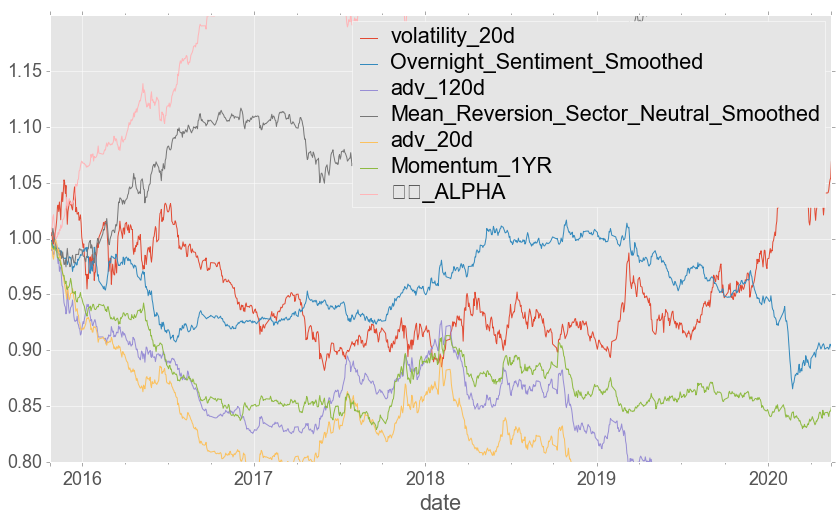

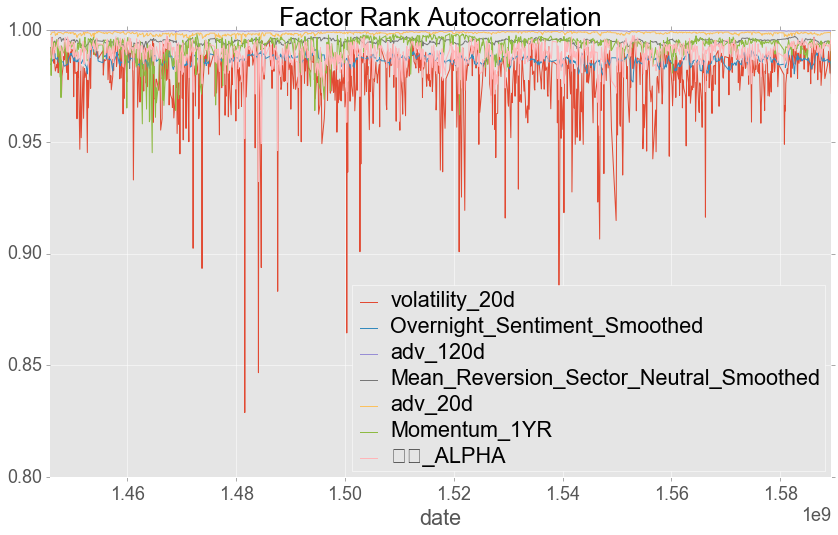

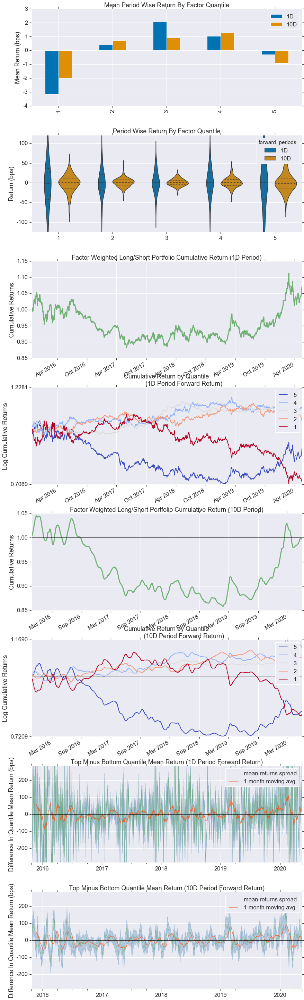

Information Analysis


,1D,10D
IC Mean,-0.01800000,-0.03800000
IC Std.,0.21700000,0.20500000
Risk-Adjusted IC,-0.08500000,-0.18500000
t-stat(IC),-2.82900000,-6.15400000
p-value(IC),0.00500000,0.00000000
IC Skew,0.22200000,0.16400000
IC Kurtosis,-0.17700000,-0.31300000


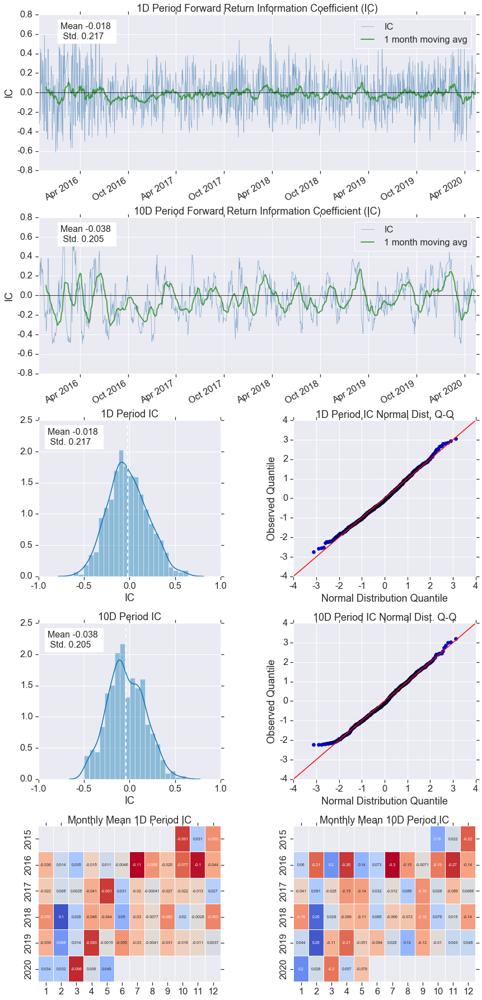

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.31800000,0.07900000
Quantile 2 Mean Turnover,0.58900000,0.17600000
Quantile 3 Mean Turnover,0.63100000,0.20000000
Quantile 4 Mean Turnover,0.60600000,0.18200000
Quantile 5 Mean Turnover,0.38700000,0.08800000


,1D,10D
Mean Factor Rank Autocorrelation,0.97900000,0.78400000


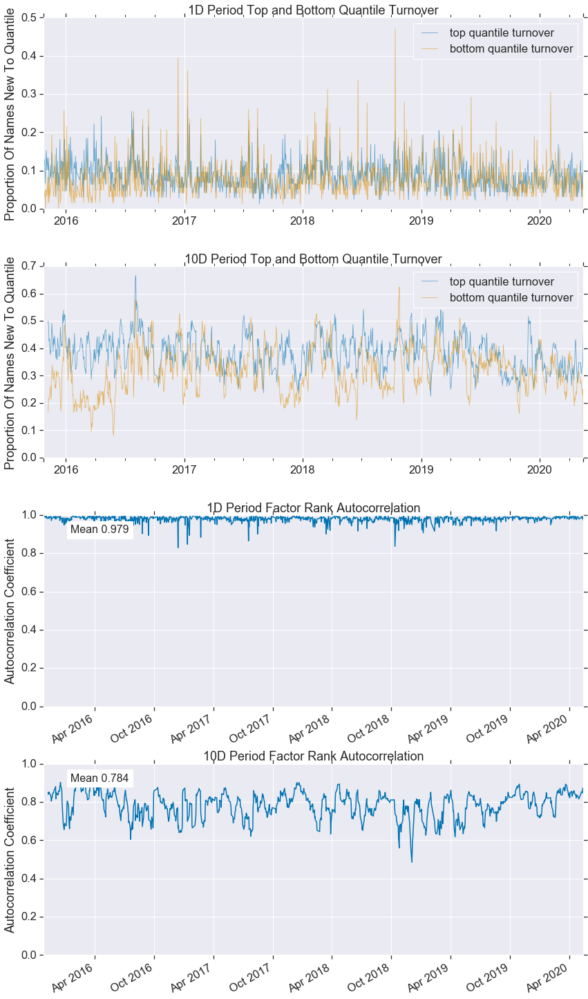

Overnight_Sentiment_Smoothed
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72854108,-0.75184510,-1.37152613,0.20325093,87042,20.10755818
2,-1.19078812,-0.06911959,-0.68895729,0.19944507,86329,19.94284817
3,-0.52767272,0.58954943,-0.01604340,0.20522071,86369,19.95208856
4,0.11681304,1.27883933,0.66816051,0.21586221,86329,19.94284817
5,0.78692922,1.72853395,1.37201784,0.20924245,86813,20.05465693


Returns Analysis


,1D,10D
Ann. alpha,-0.01800000,-0.00600000
beta,-0.04700000,-0.06600000
Mean Period Wise Return Top Quantile (bps),0.04600000,0.03200000
Mean Period Wise Return Bottom Quantile (bps),1.38800000,0.98400000
Mean Period Wise Spread (bps),-1.33200000,-0.87700000


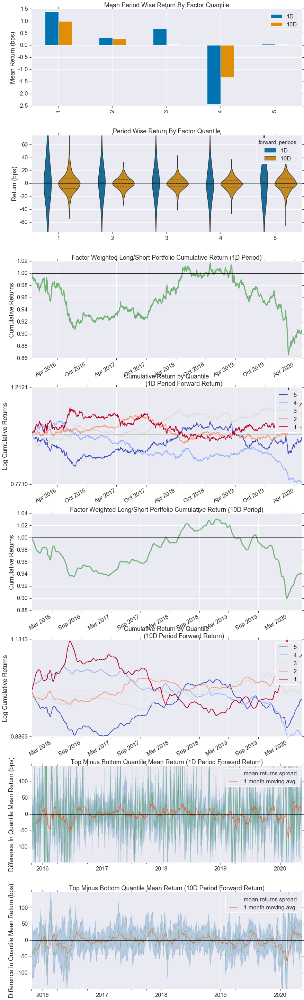

Information Analysis


,1D,10D
IC Mean,0.00300000,0.00400000
IC Std.,0.10000000,0.10600000
Risk-Adjusted IC,0.02600000,0.04200000
t-stat(IC),0.85100000,1.39700000
p-value(IC),0.39500000,0.16300000
IC Skew,-0.13200000,-0.41800000
IC Kurtosis,1.43600000,1.61500000


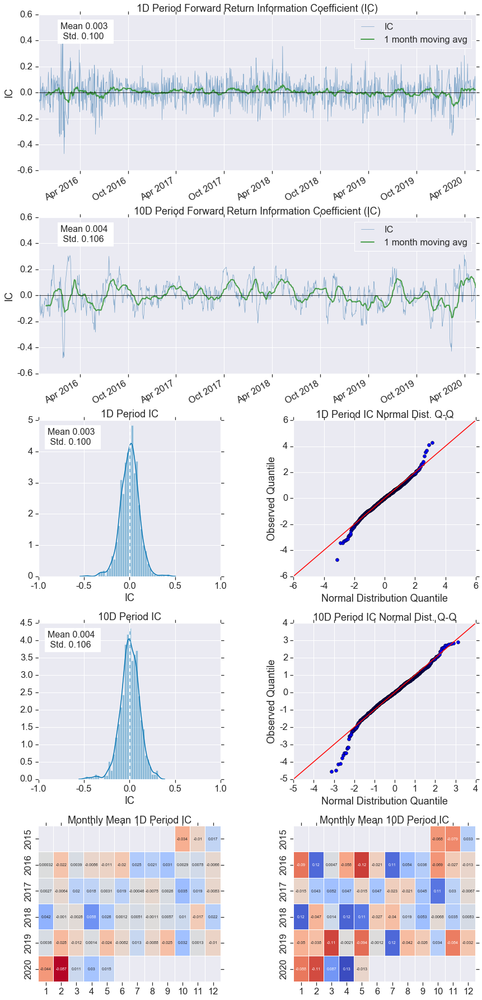

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.59900000,0.09200000
Quantile 2 Mean Turnover,0.75800000,0.20700000
Quantile 3 Mean Turnover,0.77800000,0.24000000
Quantile 4 Mean Turnover,0.75700000,0.21700000
Quantile 5 Mean Turnover,0.64200000,0.09800000


,1D,10D
Mean Factor Rank Autocorrelation,0.98700000,0.38100000


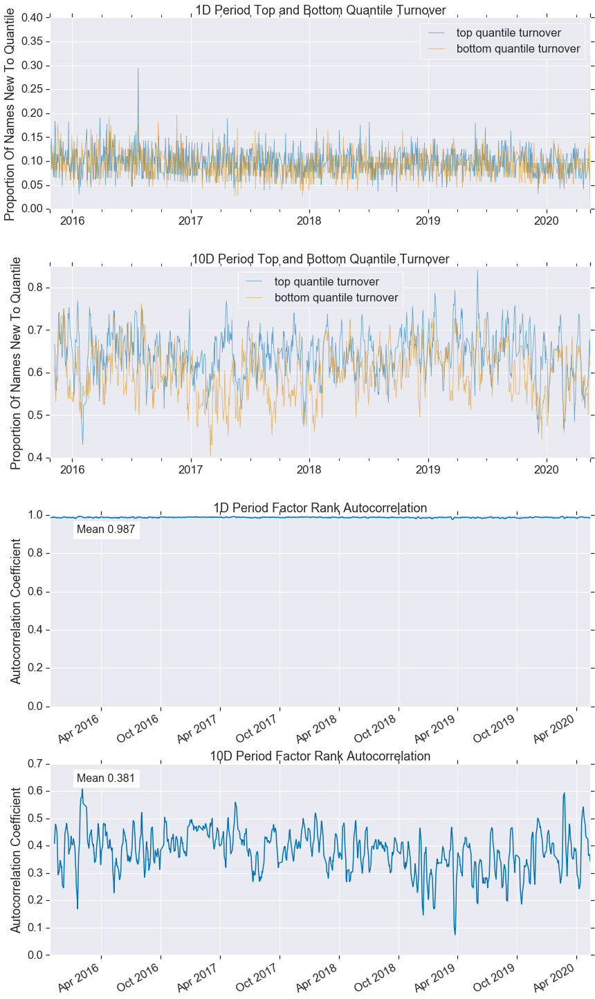

adv_120d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72850515,-0.71391517,-1.31674298,0.21990249,87042,20.10755818
2,-1.06449187,-0.03245069,-0.61041963,0.21130214,86329,19.94284817
3,-0.38329392,0.61656310,0.07011387,0.20724290,86369,19.95208856
4,0.28204647,1.26478615,0.73501803,0.19989170,86329,19.94284817
5,0.99077861,1.72854108,1.40387188,0.19292736,86813,20.05465693


Returns Analysis


,1D,10D
Ann. alpha,-0.08400000,-0.08900000
beta,-0.00800000,-0.05100000
Mean Period Wise Return Top Quantile (bps),-2.84800000,-3.13200000
Mean Period Wise Return Bottom Quantile (bps),4.81600000,5.74000000
Mean Period Wise Spread (bps),-7.40200000,-8.51500000


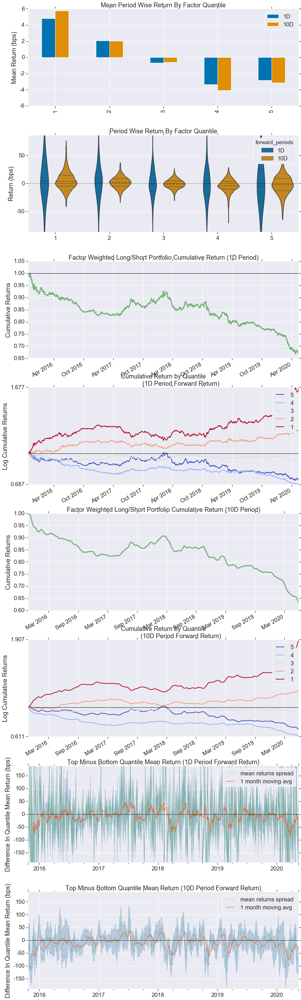

Information Analysis


,1D,10D
IC Mean,-0.00800000,-0.03700000
IC Std.,0.13900000,0.15400000
Risk-Adjusted IC,-0.05800000,-0.23800000
t-stat(IC),-1.92100000,-7.92400000
p-value(IC),0.05500000,0.00000000
IC Skew,0.10100000,-0.10500000
IC Kurtosis,0.01800000,-0.05300000


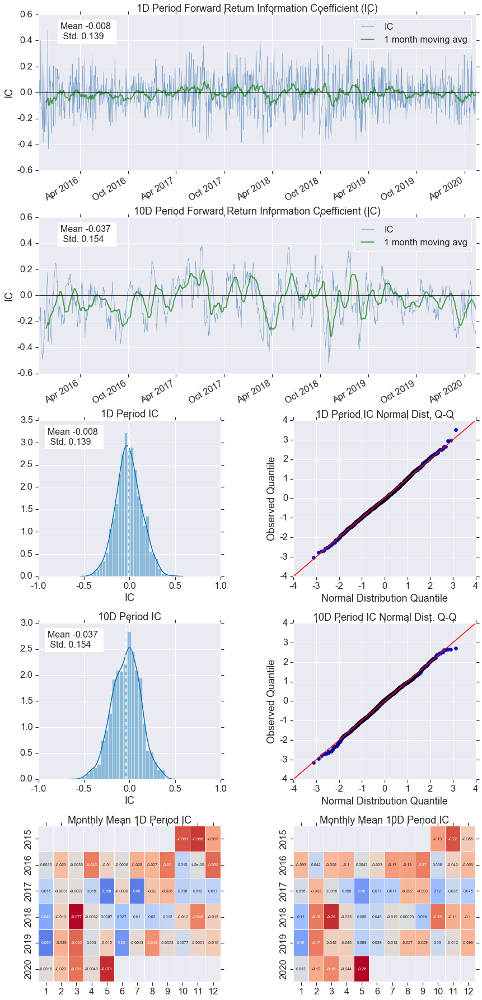

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.09400000,0.01700000
Quantile 2 Mean Turnover,0.14900000,0.02700000
Quantile 3 Mean Turnover,0.16000000,0.02900000
Quantile 4 Mean Turnover,0.13500000,0.02600000
Quantile 5 Mean Turnover,0.06500000,0.01300000


,1D,10D
Mean Factor Rank Autocorrelation,1.00000000,0.99500000


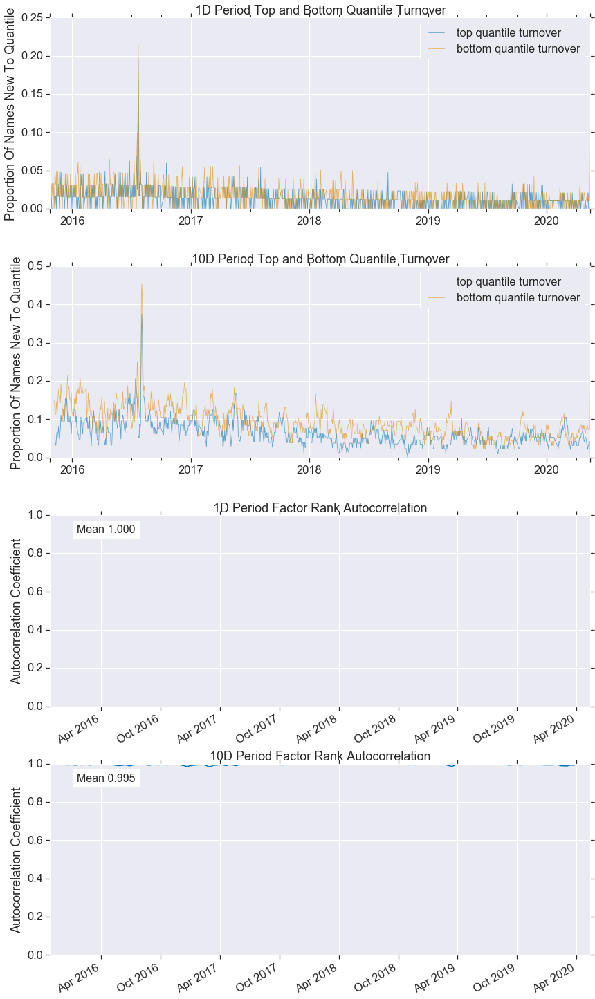

Mean_Reversion_Sector_Neutral_Smoothed
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72850515,-0.75777460,-1.36941617,0.20373311,87042,20.10755818
2,-1.08978628,-0.06495211,-0.68110257,0.19950012,86329,19.94284817
3,-0.44858999,0.59322926,-0.00154101,0.20111677,86369,19.95208856
4,0.21292410,1.13882696,0.68217839,0.20145900,86329,19.94284817
5,0.89917727,1.72850515,1.37426825,0.20481465,86813,20.05465693


Returns Analysis


,1D,10D
Ann. alpha,0.04900000,0.03500000
beta,0.01600000,0.05700000
Mean Period Wise Return Top Quantile (bps),2.69600000,2.21300000
Mean Period Wise Return Bottom Quantile (bps),-1.90100000,-0.98900000
Mean Period Wise Spread (bps),4.79600000,3.29700000


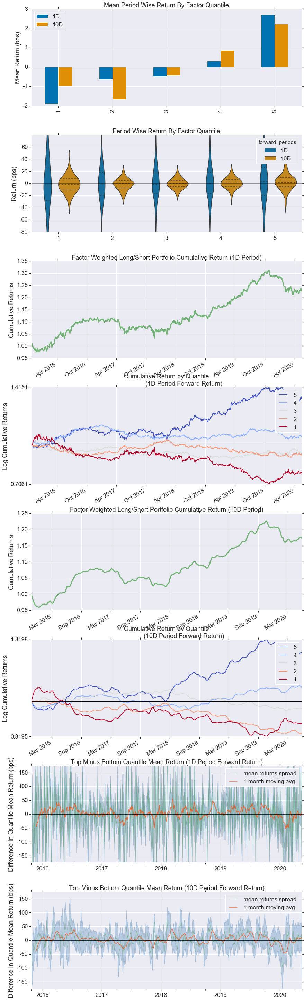

Information Analysis


,1D,10D
IC Mean,0.01100000,0.02400000
IC Std.,0.12000000,0.12000000
Risk-Adjusted IC,0.09300000,0.20300000
t-stat(IC),3.09400000,6.75000000
p-value(IC),0.00200000,0.00000000
IC Skew,0.03100000,0.00900000
IC Kurtosis,0.12200000,-0.23800000


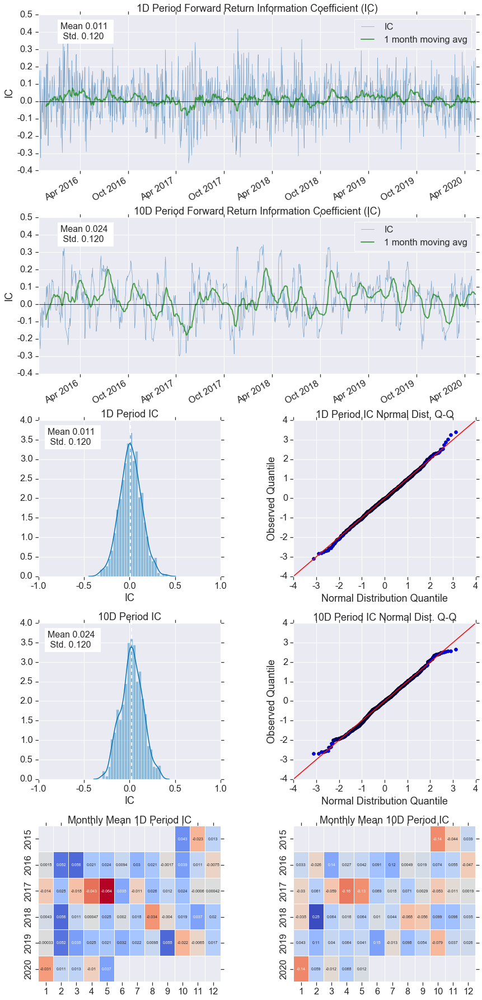

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.46400000,0.06100000
Quantile 2 Mean Turnover,0.70200000,0.13100000
Quantile 3 Mean Turnover,0.73500000,0.14900000
Quantile 4 Mean Turnover,0.70500000,0.13200000
Quantile 5 Mean Turnover,0.47300000,0.06200000


,1D,10D
Mean Factor Rank Autocorrelation,0.99500000,0.67100000


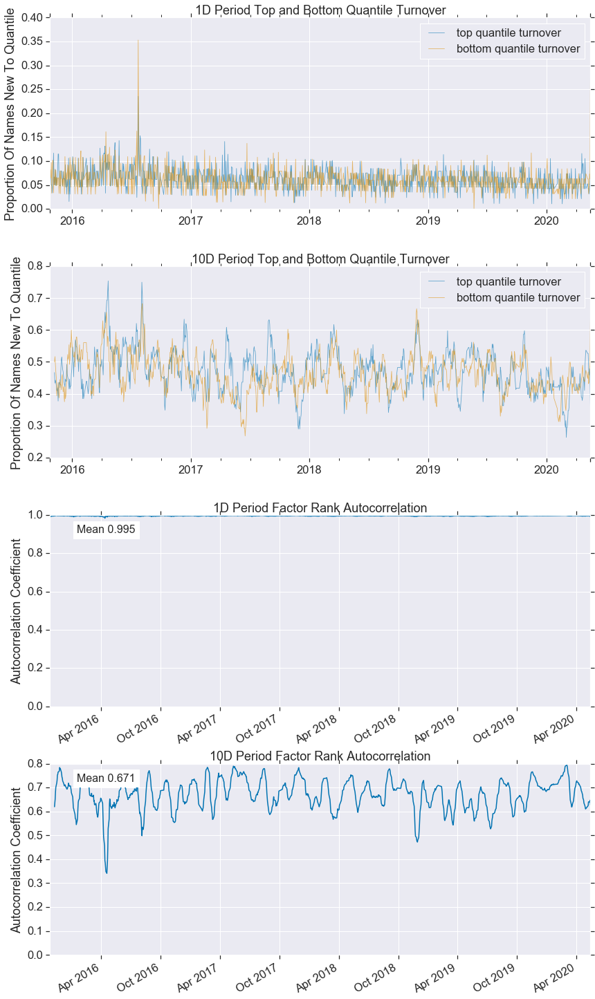

adv_20d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72850515,-0.71391517,-1.27789559,0.22169510,87042,20.10755818
2,-1.17344049,-0.04867603,-0.59745080,0.21193127,86329,19.94284817
3,-0.38329392,0.59222509,0.07461916,0.20848381,86369,19.95208856
4,0.26758255,1.19880690,0.73964797,0.20006112,86329,19.94284817
5,0.98198074,1.72854108,1.40290405,0.19266463,86813,20.05465693


Returns Analysis


,1D,10D
Ann. alpha,-0.09900000,-0.10000000
beta,0.02100000,-0.03200000
Mean Period Wise Return Top Quantile (bps),-4.63600000,-4.62300000
Mean Period Wise Return Bottom Quantile (bps),4.86400000,4.89500000
Mean Period Wise Spread (bps),-9.51200000,-9.52800000


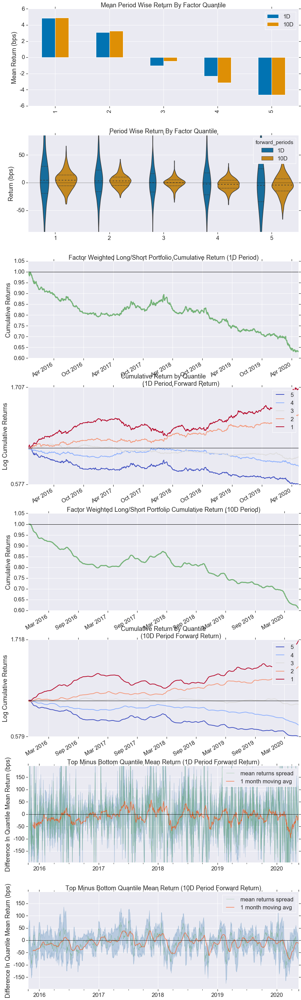

Information Analysis


,1D,10D
IC Mean,-0.01600000,-0.05100000
IC Std.,0.14500000,0.16400000
Risk-Adjusted IC,-0.11200000,-0.31400000
t-stat(IC),-3.72200000,-10.45200000
p-value(IC),0.00000000,0.00000000
IC Skew,0.08700000,0.05300000
IC Kurtosis,0.01100000,-0.41000000


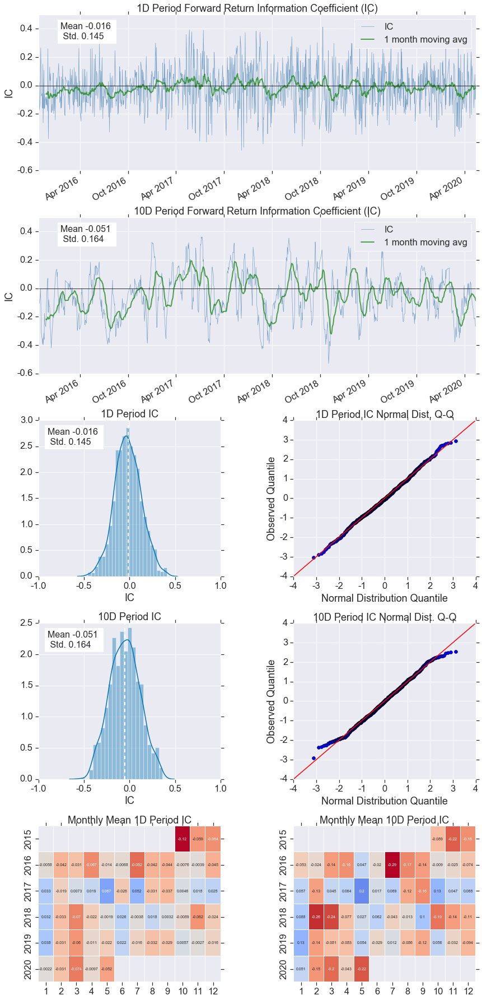

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.18500000,0.03200000
Quantile 2 Mean Turnover,0.36800000,0.06400000
Quantile 3 Mean Turnover,0.40700000,0.07100000
Quantile 4 Mean Turnover,0.35000000,0.05900000
Quantile 5 Mean Turnover,0.16000000,0.02700000


,1D,10D
Mean Factor Rank Autocorrelation,0.99900000,0.95400000


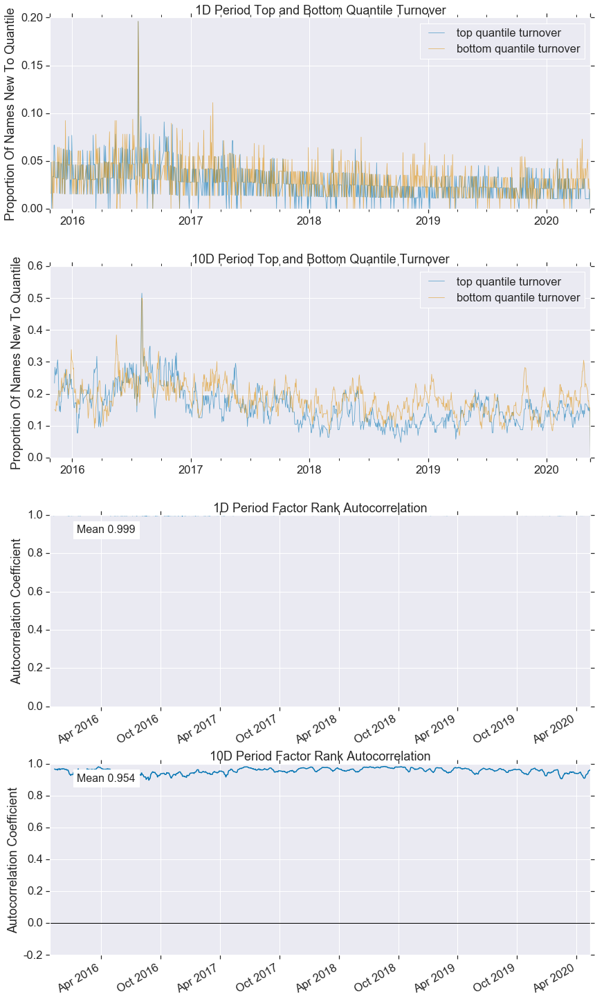

Momentum_1YR
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72844612,-0.83890744,-1.38297619,0.20139049,87042,20.10755818
2,-1.07873801,-0.14463921,-0.68958689,0.19982802,86329,19.94284817
3,-0.40009532,0.38031937,0.00164821,0.19974625,86369,19.95208856
4,0.27854737,1.06904497,0.69068499,0.19924422,86329,19.94284817
5,0.84613940,1.72844612,1.38246429,0.20099681,86813,20.05465693


Returns Analysis


,1D,10D
Ann. alpha,-0.03400000,-0.03000000
beta,-0.01500000,-0.04800000
Mean Period Wise Return Top Quantile (bps),-1.52100000,-1.05000000
Mean Period Wise Return Bottom Quantile (bps),1.50300000,1.55400000
Mean Period Wise Spread (bps),-3.53400000,-3.12900000


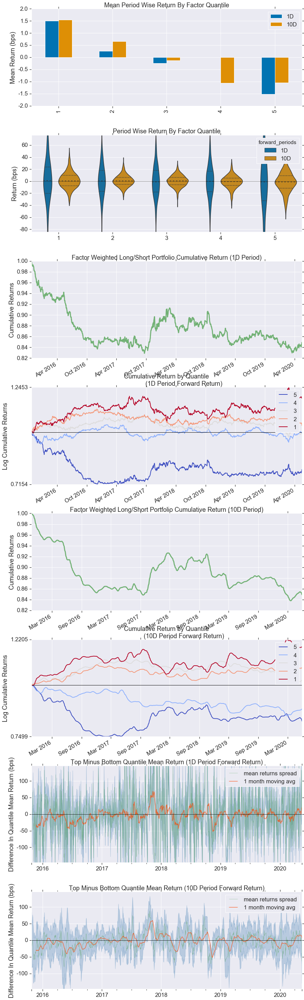

Information Analysis


,1D,10D
IC Mean,-0.00000000,-0.00300000
IC Std.,0.11100000,0.12100000
Risk-Adjusted IC,-0.00100000,-0.02100000
t-stat(IC),-0.04700000,-0.71500000
p-value(IC),0.96300000,0.47500000
IC Skew,0.09100000,0.02900000
IC Kurtosis,0.45300000,0.29000000


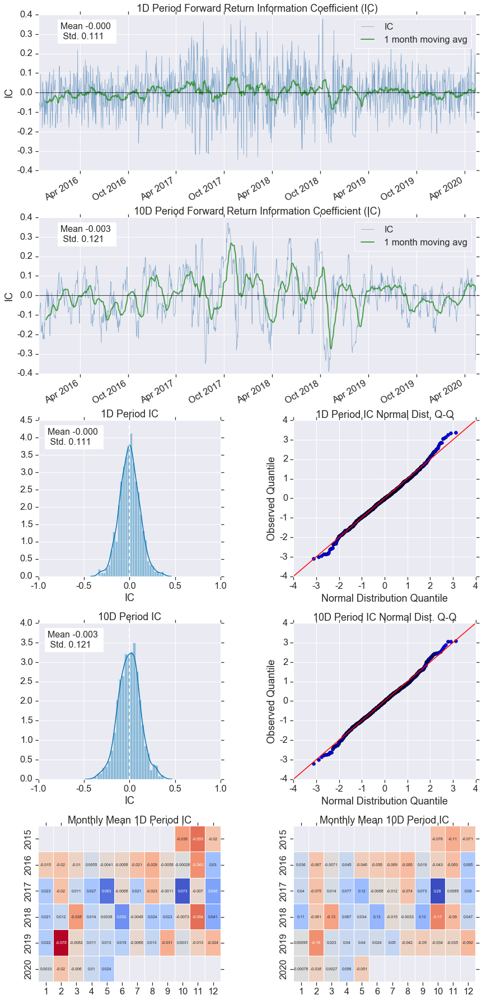

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.18700000,0.05600000
Quantile 2 Mean Turnover,0.36500000,0.12100000
Quantile 3 Mean Turnover,0.40200000,0.14200000
Quantile 4 Mean Turnover,0.36400000,0.12600000
Quantile 5 Mean Turnover,0.19200000,0.05900000


,1D,10D
Mean Factor Rank Autocorrelation,0.99300000,0.93600000


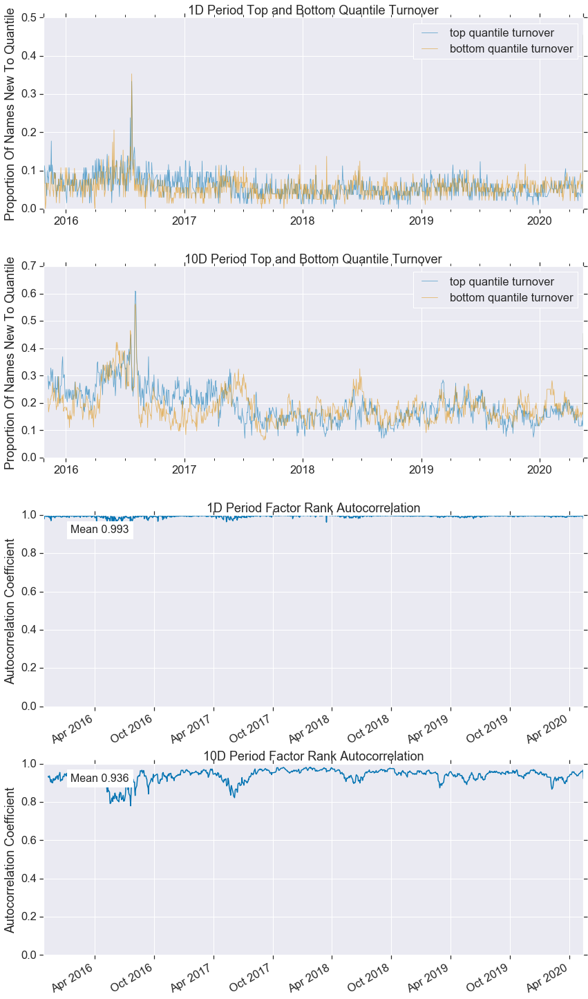

增强_ALPHA
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.02653081,-0.00164756,-0.01310482,0.00498047,87042,20.10755818
2,-0.01100210,0.00349351,-0.00294998,0.00281500,86329,19.94284817
3,-0.00435895,0.01568708,0.00533470,0.00346343,86372,19.95278159
4,0.00729731,0.02664210,0.01656882,0.00374502,86326,19.94215514
5,0.01605738,0.03403036,0.02405348,0.00336869,86813,20.05465693


Returns Analysis


,1D,10D
Ann. alpha,0.10900000,0.11200000
beta,-0.07200000,-0.03000000
Mean Period Wise Return Top Quantile (bps),3.48700000,4.10000000
Mean Period Wise Return Bottom Quantile (bps),-4.79100000,-5.12600000
Mean Period Wise Spread (bps),8.38700000,9.59200000


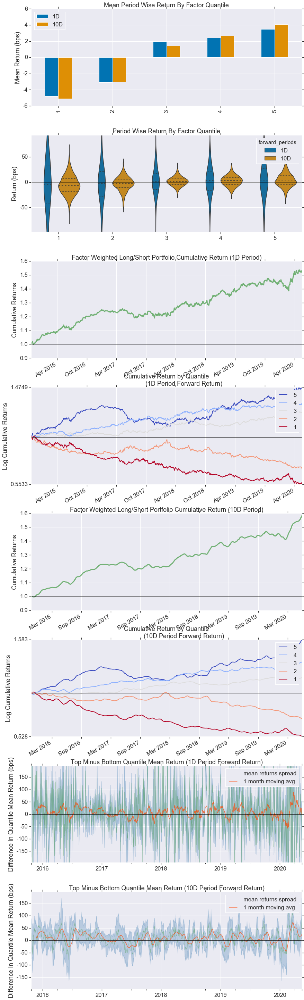

Information Analysis


,1D,10D
IC Mean,0.02300000,0.06600000
IC Std.,0.13400000,0.13900000
Risk-Adjusted IC,0.17400000,0.47700000
t-stat(IC),5.79900000,15.88000000
p-value(IC),0.00000000,0.00000000
IC Skew,-0.00500000,0.04600000
IC Kurtosis,0.17800000,-0.68700000


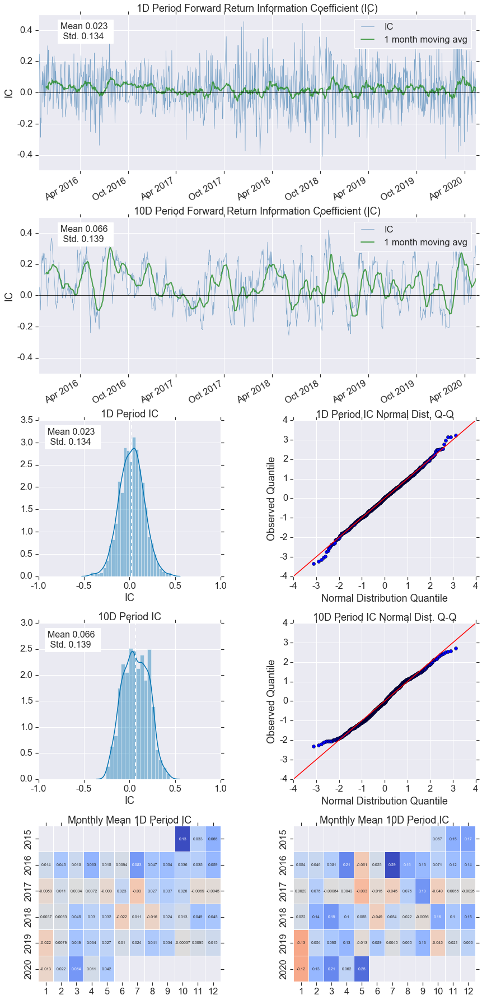

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.33500000,0.07400000
Quantile 2 Mean Turnover,0.45200000,0.13000000
Quantile 3 Mean Turnover,0.52100000,0.12900000
Quantile 4 Mean Turnover,0.45600000,0.11300000
Quantile 5 Mean Turnover,0.27100000,0.05700000


,1D,10D
Mean Factor Rank Autocorrelation,0.98900000,0.85900000


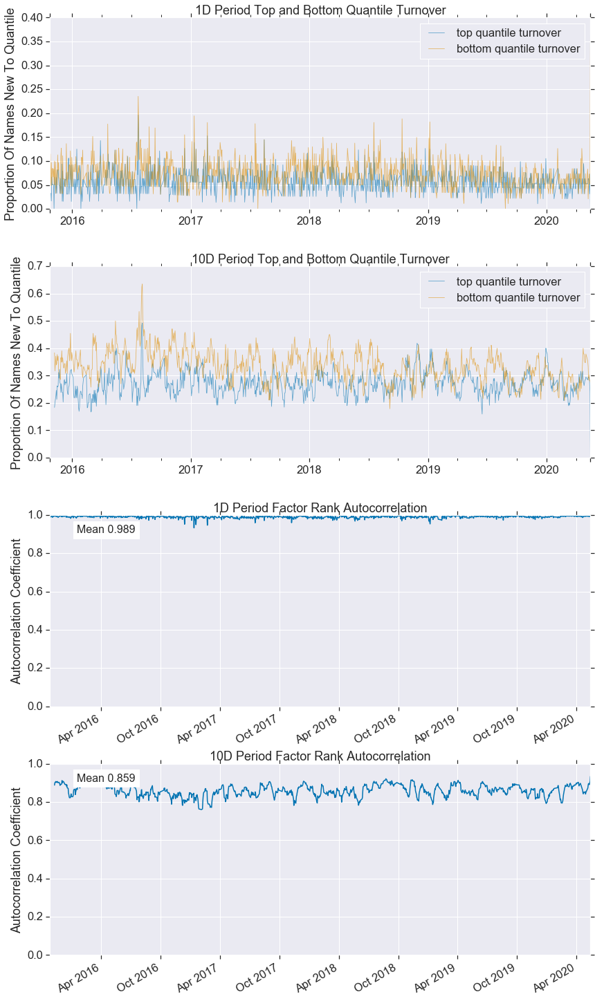

volatility_20d                           -0.01845548
Overnight_Sentiment_Smoothed              0.00255537
adv_120d                                 -0.00803534
Mean_Reversion_Sector_Neutral_Smoothed    0.01110403
adv_20d                                  -0.01622689
Momentum_1YR                             -0.00015555
增强_ALPHA                                  0.02331929
dtype: float64


In [32]:
n_trees = 300
n_skip_samples = 9

clf = RandomForestClassifier(n_trees, **clf_parameters)
clf_nov = NoOverlapVoter(clf, n_skip_samples =n_skip_samples)
clf_nov.fit(
    pd.concat([X_train, X_valid]),
    pd.concat([y_train, y_valid]))

print('train: {}, oob: {}, valid: {}'.format(
    clf_nov.score(X_train, y_train.values),
    clf_nov.score(X_valid, y_valid.values),
    clf_nov.oob_score_))

factor_IC = show_sample_results(all_factors, pd.concat([X_train, X_valid]), clf_nov, factor_names)

#### Test

[ 0.48990897  0.51009103]
Cleaning Data...

Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss

,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72858323,-0.99777574,-1.38217905,0.19858107,9681,20.08964701
2,-1.05519940,-0.30214336,-0.70061914,0.19541971,9617,19.95683662
3,-0.38181557,0.38646244,-0.02410956,0.19623710,9616,19.95476146
4,0.29392437,1.03993528,0.65996458,0.19976440,9617,19.95683662
5,0.98126465,1.72858323,1.36777084,0.21100008,9658,20.04191828


Returns Analysis


,1D,10D
Ann. alpha,-0.03700000,-0.06800000
beta,0.17000000,0.09900000
Mean Period Wise Return Top Quantile (bps),5.20300000,0.24400000
Mean Period Wise Return Bottom Quantile (bps),-4.28400000,0.97000000
Mean Period Wise Spread (bps),9.86400000,-0.71700000


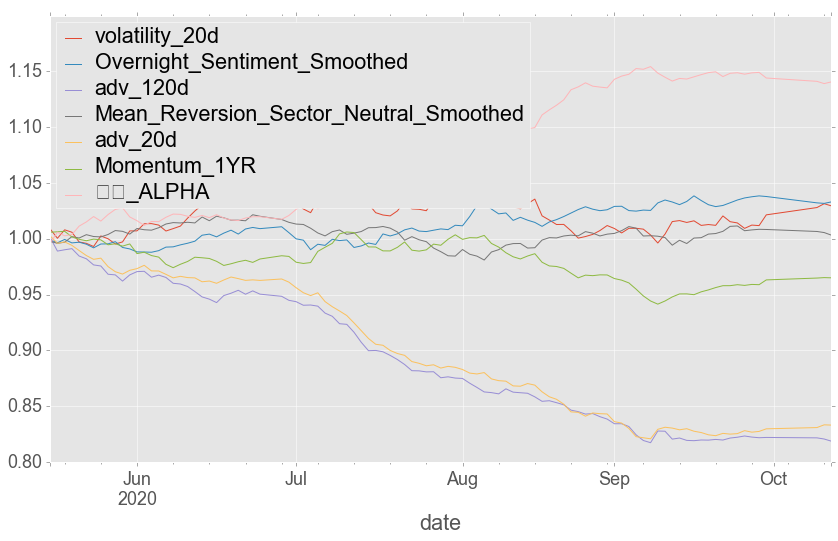

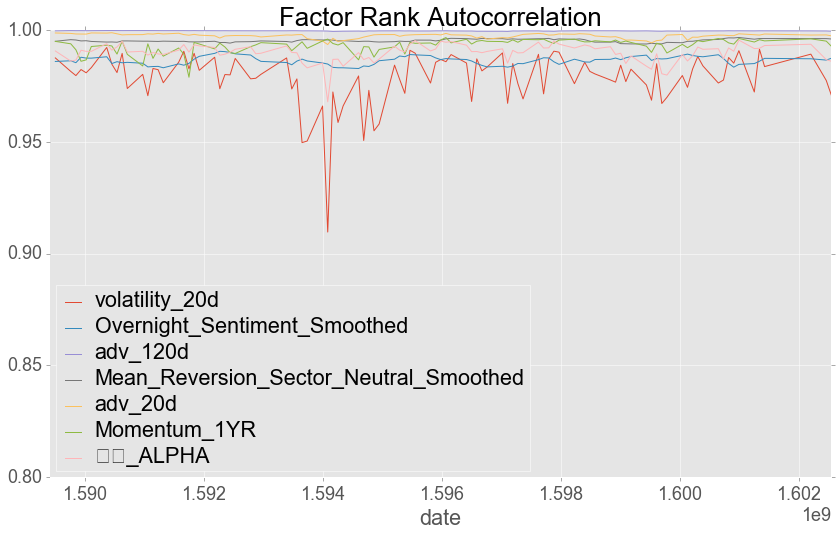

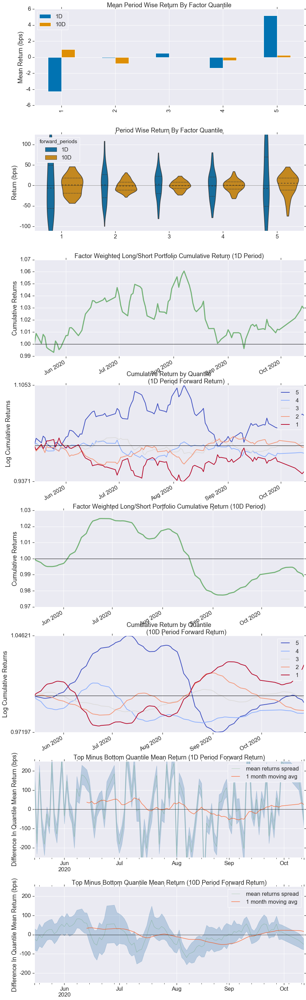

Information Analysis


,1D,10D
IC Mean,-0.02400000,-0.05400000
IC Std.,0.18000000,0.17200000
Risk-Adjusted IC,-0.13100000,-0.31700000
t-stat(IC),-1.31800000,-3.18200000
p-value(IC),0.19100000,0.00200000
IC Skew,0.20700000,-0.18900000
IC Kurtosis,-0.51600000,-0.69200000


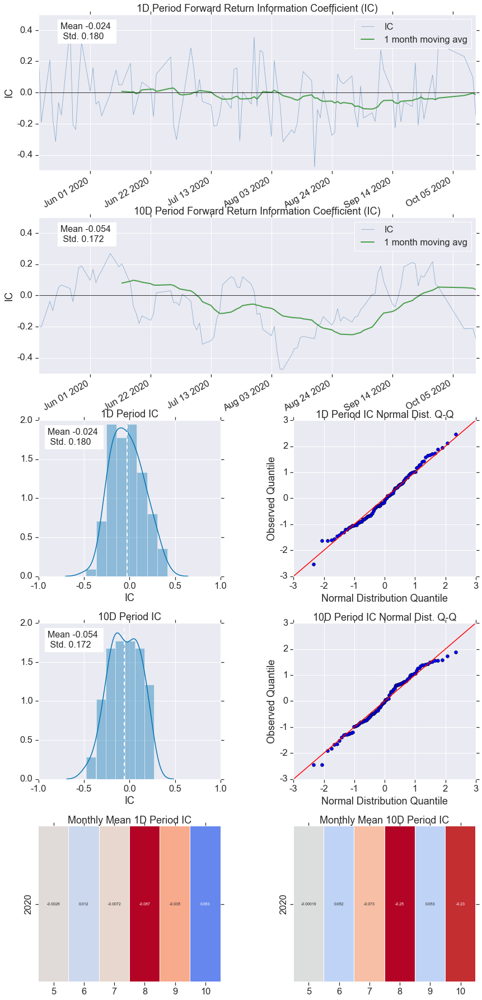

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.34500000,0.08500000
Quantile 2 Mean Turnover,0.61200000,0.19100000
Quantile 3 Mean Turnover,0.64700000,0.21400000
Quantile 4 Mean Turnover,0.61300000,0.18000000
Quantile 5 Mean Turnover,0.36400000,0.07600000


,1D,10D
Mean Factor Rank Autocorrelation,0.97900000,0.74600000


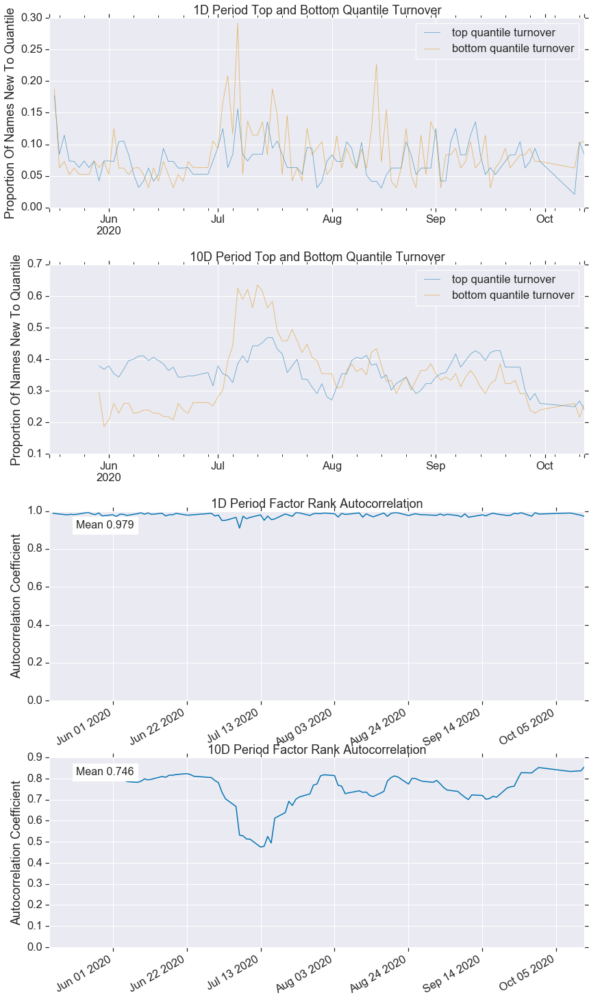

Overnight_Sentiment_Smoothed
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72858323,-0.98974532,-1.37137262,0.20672006,9681,20.08964701
2,-1.07506823,-0.29851036,-0.66966981,0.20050471,9617,19.95683662
3,-0.36538267,0.38875768,0.01635276,0.19760987,9616,19.95476146
4,0.32322313,1.06214151,0.69877391,0.19775022,9617,19.95683662
5,1.01328686,1.72858323,1.38114822,0.19821881,9658,20.04191828


Returns Analysis


,1D,10D
Ann. alpha,0.09400000,0.09100000
beta,-0.01200000,0.01700000
Mean Period Wise Return Top Quantile (bps),3.04900000,4.34000000
Mean Period Wise Return Bottom Quantile (bps),-3.73900000,-5.33500000
Mean Period Wise Spread (bps),6.72900000,9.67600000


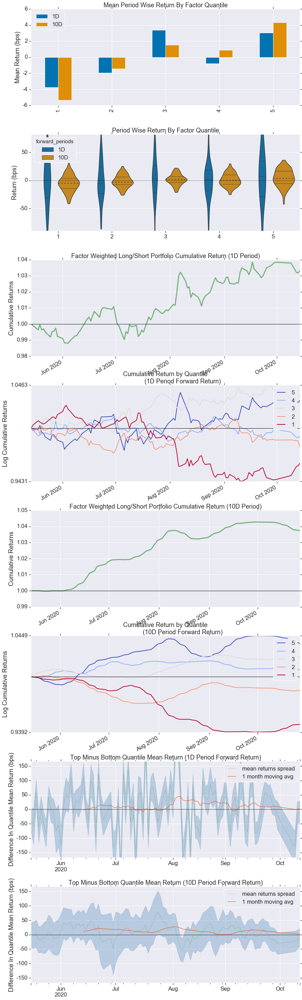

Information Analysis


,1D,10D
IC Mean,0.01900000,0.03800000
IC Std.,0.09500000,0.07500000
Risk-Adjusted IC,0.20100000,0.50600000
t-stat(IC),2.01600000,5.08500000
p-value(IC),0.04700000,0.00000000
IC Skew,-0.01700000,-0.28000000
IC Kurtosis,-0.19800000,0.01800000


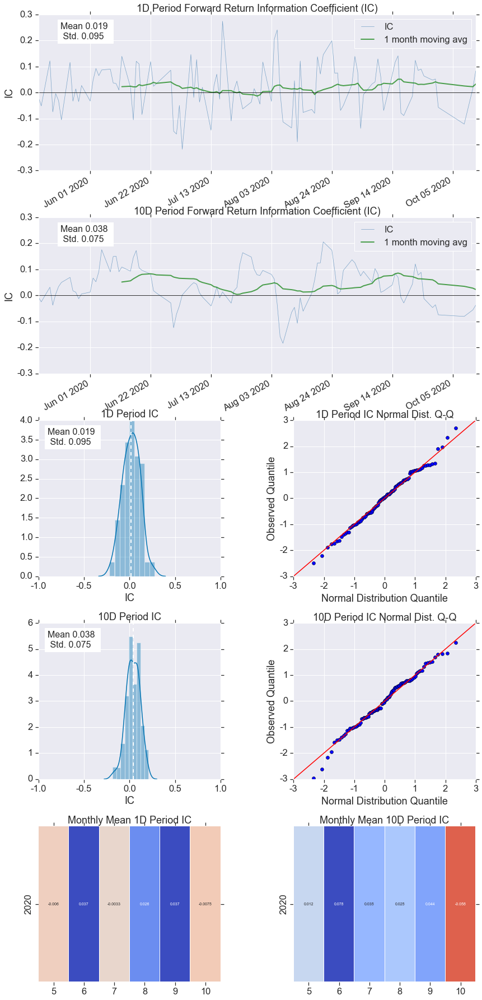

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.59800000,0.09000000
Quantile 2 Mean Turnover,0.75100000,0.21000000
Quantile 3 Mean Turnover,0.76600000,0.24000000
Quantile 4 Mean Turnover,0.75400000,0.21300000
Quantile 5 Mean Turnover,0.63100000,0.09400000


,1D,10D
Mean Factor Rank Autocorrelation,0.98600000,0.35700000


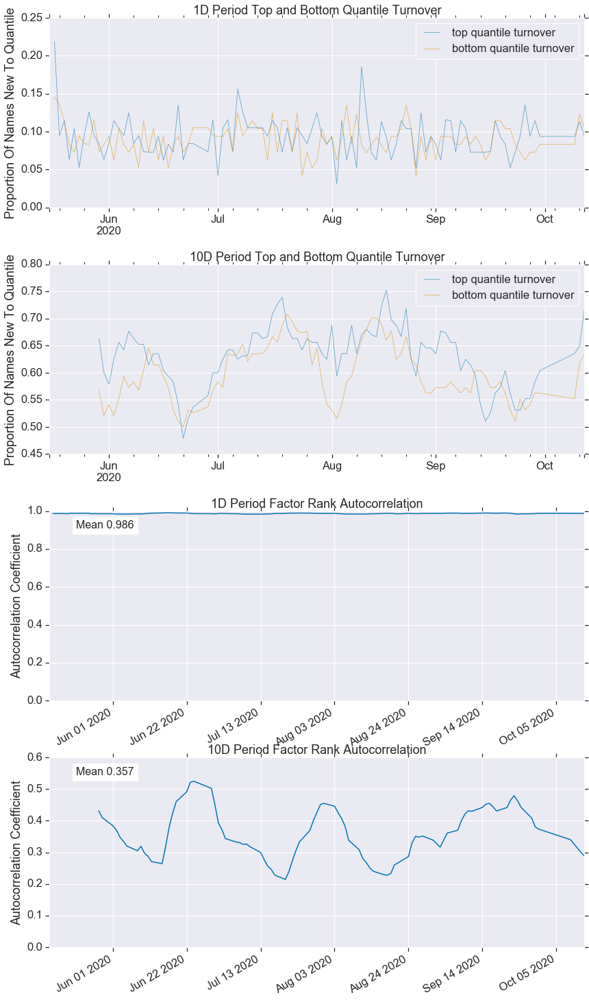

adv_120d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72858323,-0.98126465,-1.35892452,0.20896231,9681,20.08964701
2,-1.02743100,-0.29851036,-0.66119795,0.19745000,9617,19.95683662
3,-0.34009974,0.38181557,0.02073231,0.19650998,9616,19.95476146
4,0.34009974,1.06507373,0.70349474,0.19841133,9617,19.95683662
5,1.01885551,1.72858323,1.39414043,0.19557823,9658,20.04191828


Returns Analysis


,1D,10D
Ann. alpha,-0.41100000,-0.38600000
beta,0.04700000,-0.04600000
Mean Period Wise Return Top Quantile (bps),-9.84900000,-10.05500000
Mean Period Wise Return Bottom Quantile (bps),40.18500000,41.81200000
Mean Period Wise Spread (bps),-49.98400000,-51.75500000


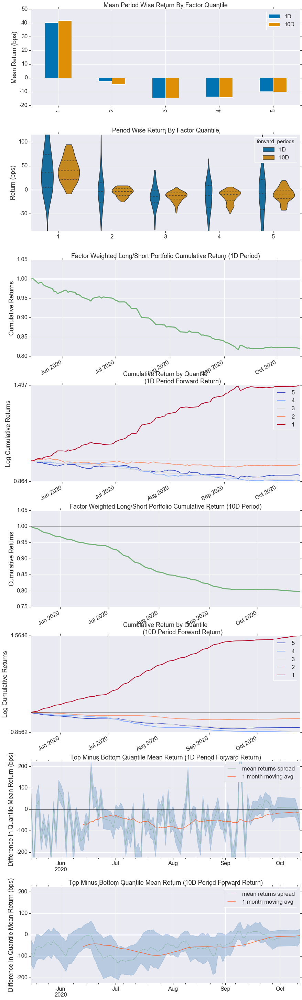

Information Analysis


,1D,10D
IC Mean,-0.03000000,-0.09700000
IC Std.,0.09600000,0.10300000
Risk-Adjusted IC,-0.31200000,-0.93400000
t-stat(IC),-3.13300000,-9.38600000
p-value(IC),0.00200000,0.00000000
IC Skew,0.31800000,-0.14400000
IC Kurtosis,0.47500000,-0.30200000


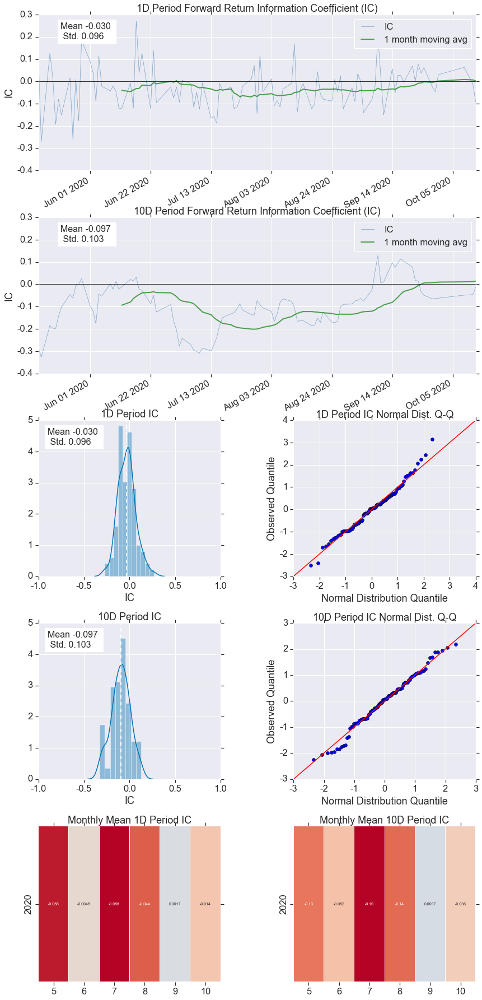

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.11100000,0.01600000
Quantile 2 Mean Turnover,0.20500000,0.02900000
Quantile 3 Mean Turnover,0.18100000,0.02700000
Quantile 4 Mean Turnover,0.11400000,0.01800000
Quantile 5 Mean Turnover,0.04100000,0.00900000


,1D,10D
Mean Factor Rank Autocorrelation,1.00000000,0.98900000


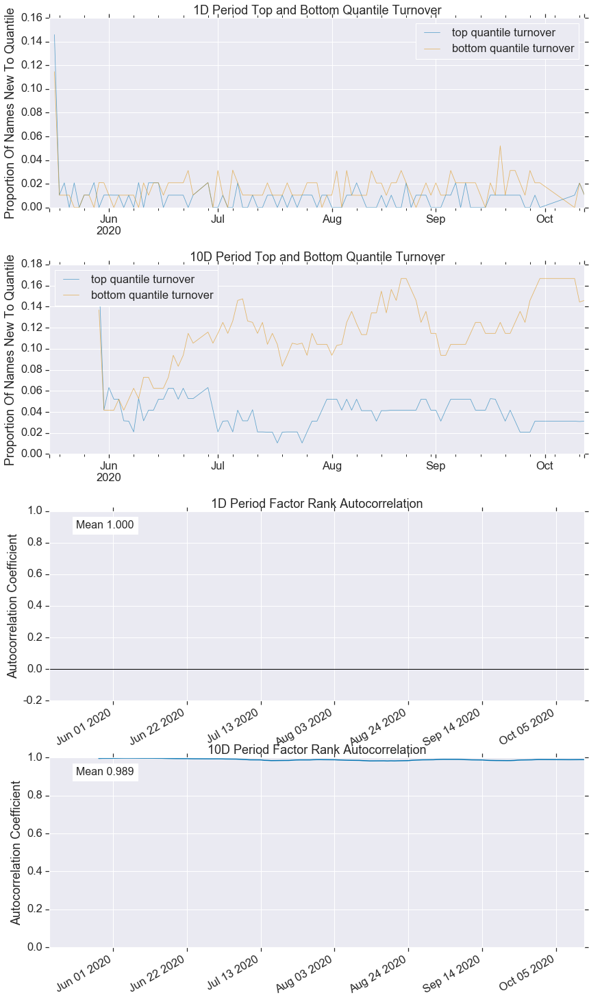

Mean_Reversion_Sector_Neutral_Smoothed
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72855524,-0.98924244,-1.37539506,0.20284323,9681,20.08964701
2,-1.04972990,-0.29923704,-0.68258599,0.19877936,9617,19.95683662
3,-0.37090457,0.37822413,0.00080660,0.19865165,9616,19.95476146
4,0.30792077,1.06237342,0.68924520,0.20083576,9617,19.95683662
5,1.00074251,1.72855524,1.38516229,0.20170660,9658,20.04191828


Returns Analysis


,1D,10D
Ann. alpha,0.05500000,0.07000000
beta,-0.06600000,-0.09500000
Mean Period Wise Return Top Quantile (bps),-0.14000000,-1.09400000
Mean Period Wise Return Bottom Quantile (bps),-1.11700000,-2.88800000
Mean Period Wise Spread (bps),0.81600000,1.78700000


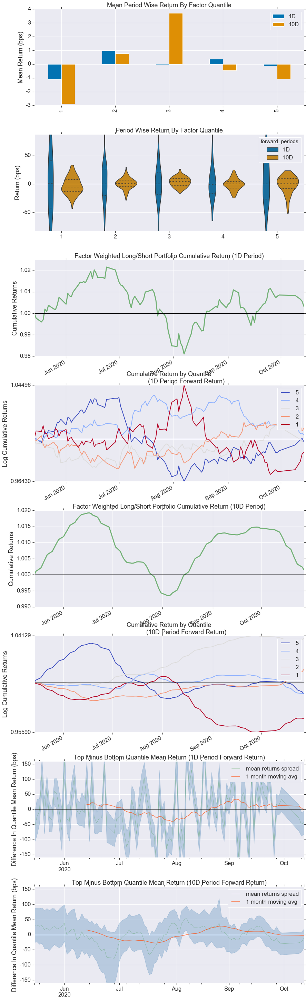

Information Analysis


,1D,10D
IC Mean,0.00900000,0.02700000
IC Std.,0.08900000,0.09200000
Risk-Adjusted IC,0.10100000,0.29500000
t-stat(IC),1.01800000,2.96200000
p-value(IC),0.31100000,0.00400000
IC Skew,0.27100000,-0.48900000
IC Kurtosis,-0.47300000,-0.74800000


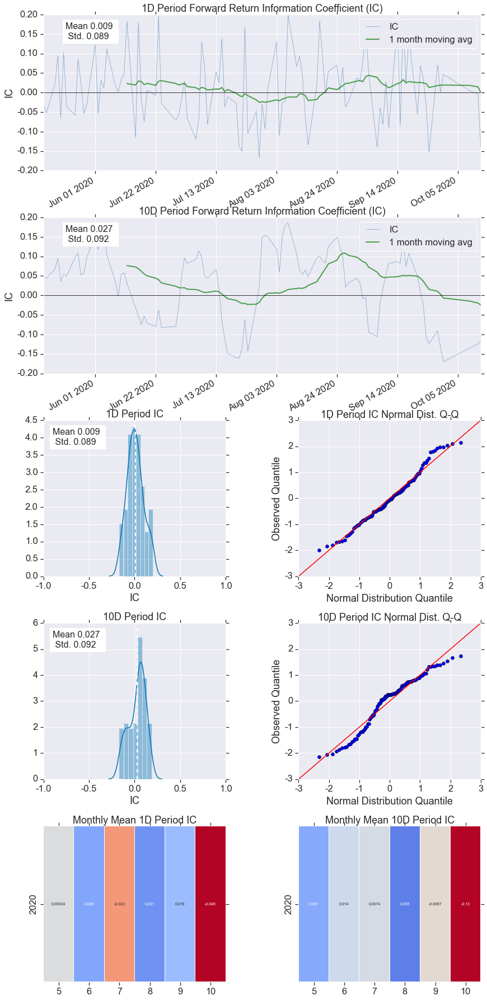

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.45200000,0.05600000
Quantile 2 Mean Turnover,0.70500000,0.12800000
Quantile 3 Mean Turnover,0.72300000,0.14400000
Quantile 4 Mean Turnover,0.71700000,0.12500000
Quantile 5 Mean Turnover,0.43800000,0.05400000


,1D,10D
Mean Factor Rank Autocorrelation,0.99500000,0.67500000


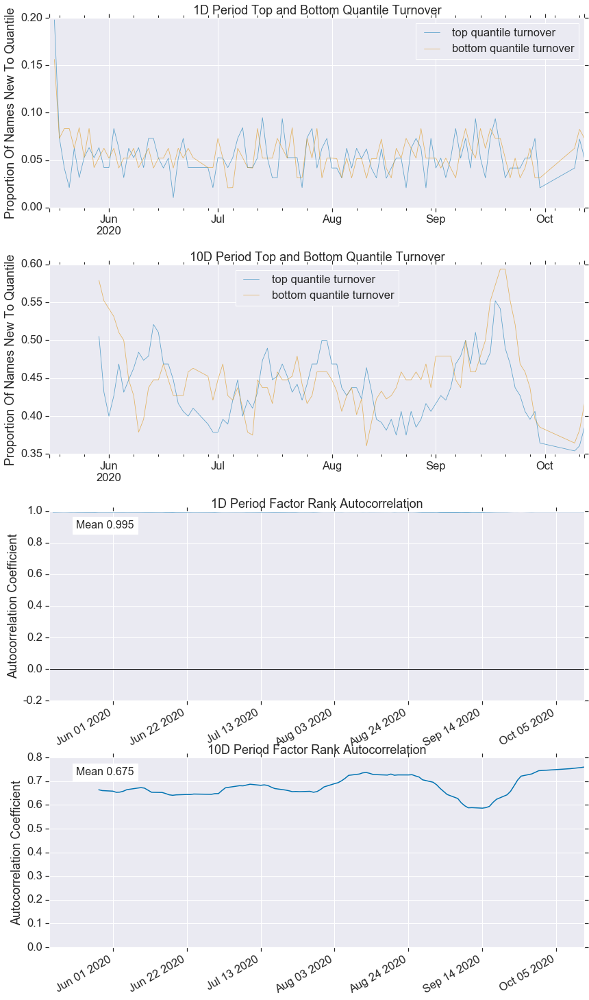

adv_20d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72857628,-0.98577839,-1.37164597,0.20081624,9681,20.08964701
2,-1.05110555,-0.30668165,-0.68229866,0.19962132,9617,19.95683662
3,-0.38490096,0.37364882,0.00465748,0.19855273,9616,19.95476146
4,0.30503791,1.06079631,0.69130263,0.20058056,9617,19.95683662
5,1.00480233,1.72858323,1.38787974,0.20034191,9658,20.04191828


Returns Analysis


,1D,10D
Ann. alpha,-0.38700000,-0.37400000
beta,0.05300000,-0.03600000
Mean Period Wise Return Top Quantile (bps),-14.21900000,-11.51000000
Mean Period Wise Return Bottom Quantile (bps),30.65100000,34.83200000
Mean Period Wise Spread (bps),-44.74400000,-46.08200000


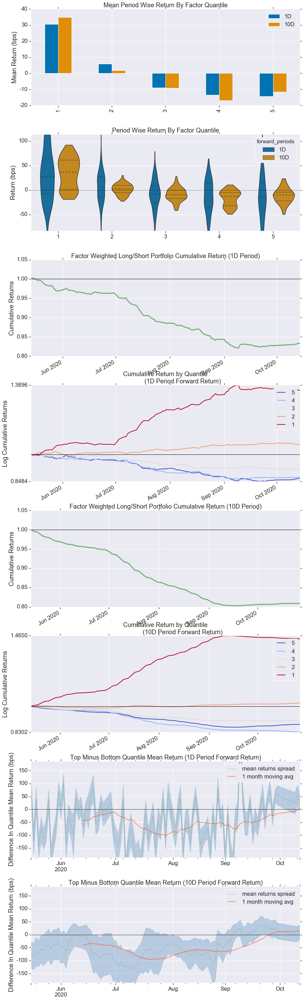

Information Analysis


,1D,10D
IC Mean,-0.04000000,-0.11300000
IC Std.,0.10000000,0.13300000
Risk-Adjusted IC,-0.39400000,-0.84700000
t-stat(IC),-3.96300000,-8.51000000
p-value(IC),0.00000000,0.00000000
IC Skew,0.23000000,0.13400000
IC Kurtosis,0.10500000,-0.88000000


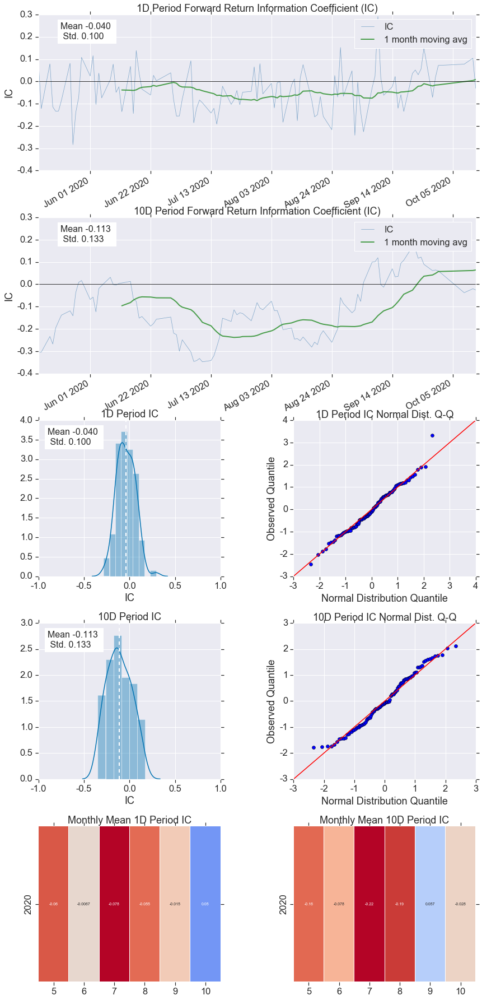

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.29900000,0.04300000
Quantile 2 Mean Turnover,0.52000000,0.09500000
Quantile 3 Mean Turnover,0.52500000,0.09400000
Quantile 4 Mean Turnover,0.41700000,0.06500000
Quantile 5 Mean Turnover,0.16400000,0.02600000


,1D,10D
Mean Factor Rank Autocorrelation,0.99800000,0.88900000


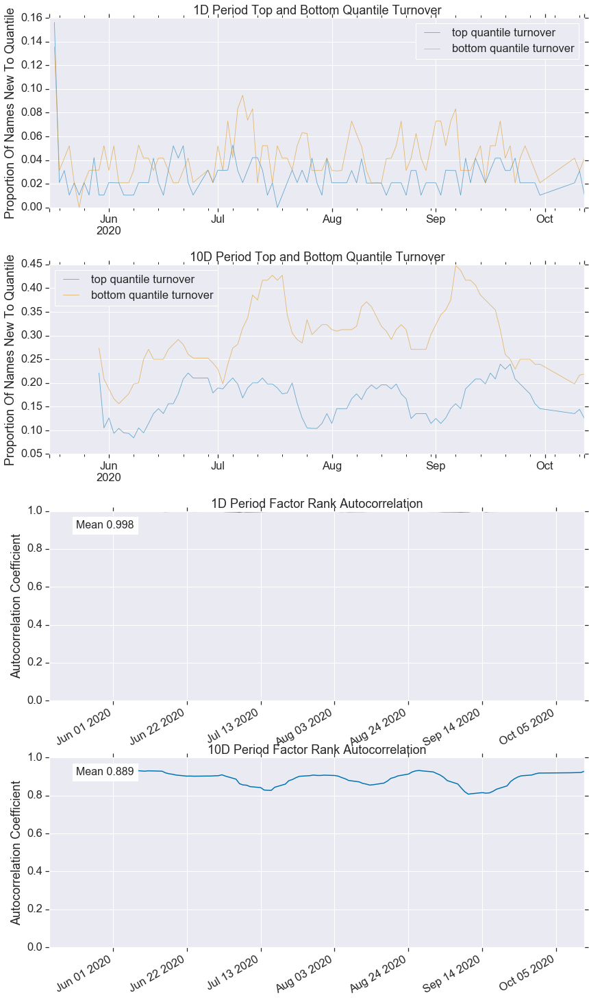

Momentum_1YR
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72847588,-1.02840740,-1.38426247,0.20067337,9681,20.08964701
2,-1.06309822,-0.33128694,-0.69010799,0.20001155,9617,19.95683662
3,-0.35436607,0.36009450,0.00138193,0.19969517,9616,19.95476146
4,0.33419309,1.06309822,0.69208227,0.19955695,9617,19.95683662
5,1.02693842,1.72847588,1.38486118,0.20040496,9658,20.04191828


Returns Analysis


,1D,10D
Ann. alpha,-0.14700000,-0.19900000
beta,0.10800000,0.13400000
Mean Period Wise Return Top Quantile (bps),-9.93000000,-13.04400000
Mean Period Wise Return Bottom Quantile (bps),1.55200000,2.41300000
Mean Period Wise Spread (bps),-11.21600000,-15.55000000


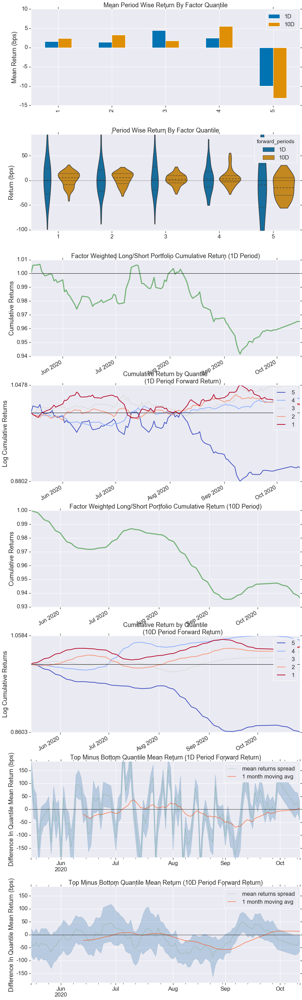

Information Analysis


,1D,10D
IC Mean,-0.01400000,-0.05200000
IC Std.,0.10300000,0.12200000
Risk-Adjusted IC,-0.13300000,-0.42700000
t-stat(IC),-1.33300000,-4.29100000
p-value(IC),0.18600000,0.00000000
IC Skew,-0.19200000,0.24000000
IC Kurtosis,-0.10400000,-1.14800000


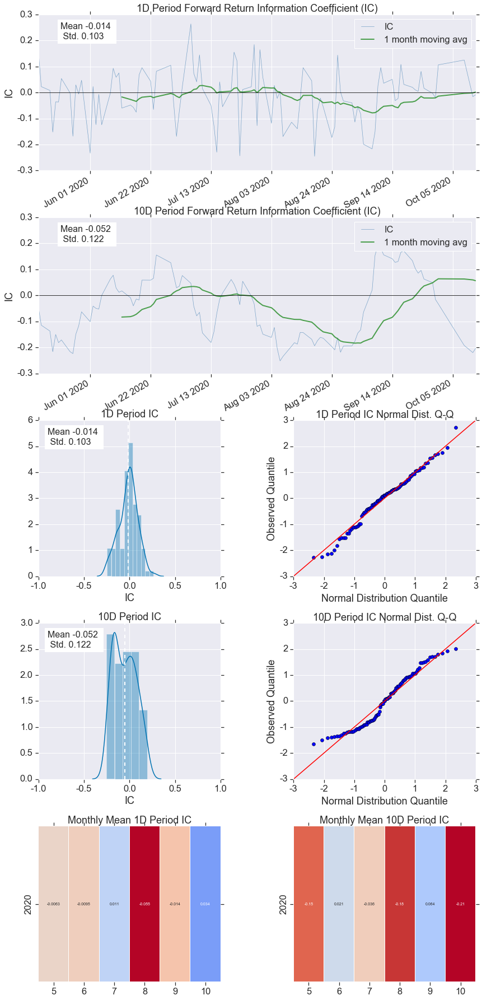

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.17400000,0.05200000
Quantile 2 Mean Turnover,0.37100000,0.12500000
Quantile 3 Mean Turnover,0.39300000,0.14500000
Quantile 4 Mean Turnover,0.37200000,0.12300000
Quantile 5 Mean Turnover,0.18200000,0.05400000


,1D,10D
Mean Factor Rank Autocorrelation,0.99300000,0.93400000


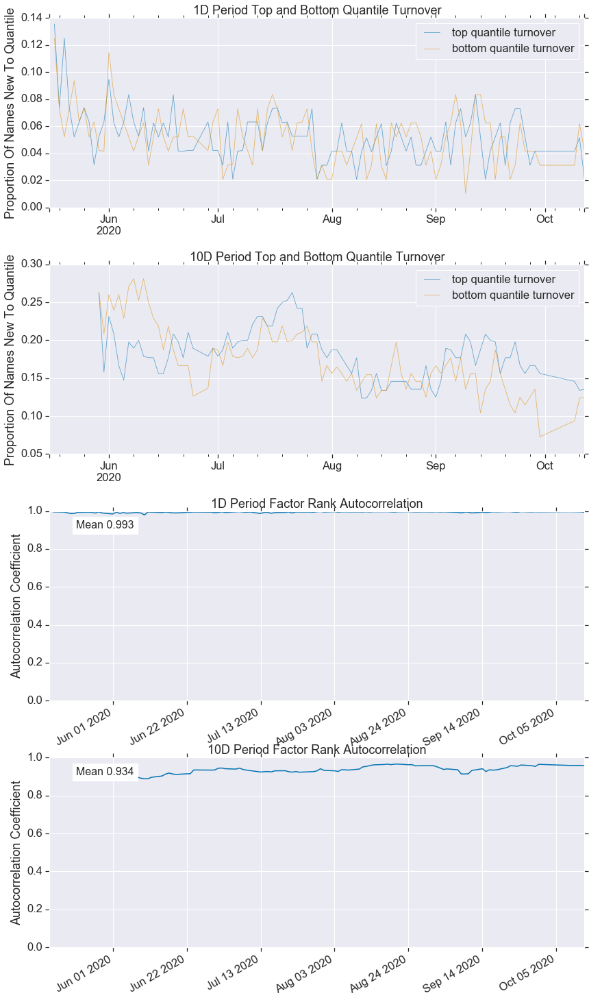

增强_ALPHA
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.02599066,-0.00553467,-0.01428862,0.00463055,9681,20.08964701
2,-0.01034649,0.00198828,-0.00418772,0.00264491,9617,19.95683662
3,-0.00210664,0.01508977,0.00641152,0.00405400,9616,19.95476146
4,0.01115698,0.02536497,0.01842962,0.00311079,9617,19.95683662
5,0.02140017,0.03352596,0.02629972,0.00222828,9658,20.04191828


Returns Analysis


,1D,10D
Ann. alpha,0.48200000,0.43700000
beta,-0.09500000,-0.00200000
Mean Period Wise Return Top Quantile (bps),16.12900000,19.61300000
Mean Period Wise Return Bottom Quantile (bps),-16.79600000,-16.46200000
Mean Period Wise Spread (bps),32.73200000,36.02200000


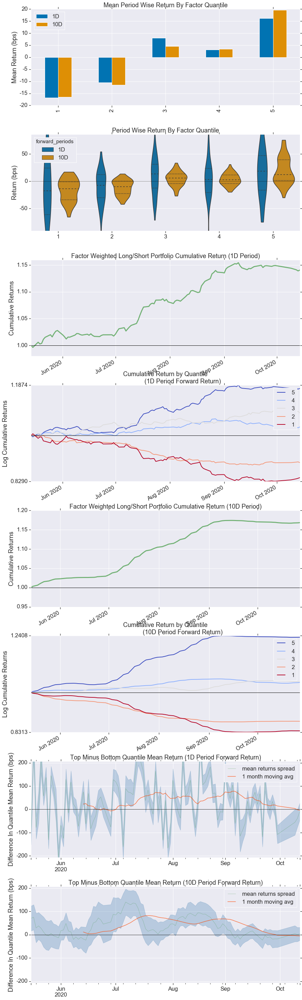

Information Analysis


,1D,10D
IC Mean,0.04100000,0.11200000
IC Std.,0.11300000,0.14000000
Risk-Adjusted IC,0.36500000,0.79700000
t-stat(IC),3.66400000,8.00700000
p-value(IC),0.00000000,0.00000000
IC Skew,-0.17700000,0.30200000
IC Kurtosis,-0.33100000,-0.95500000


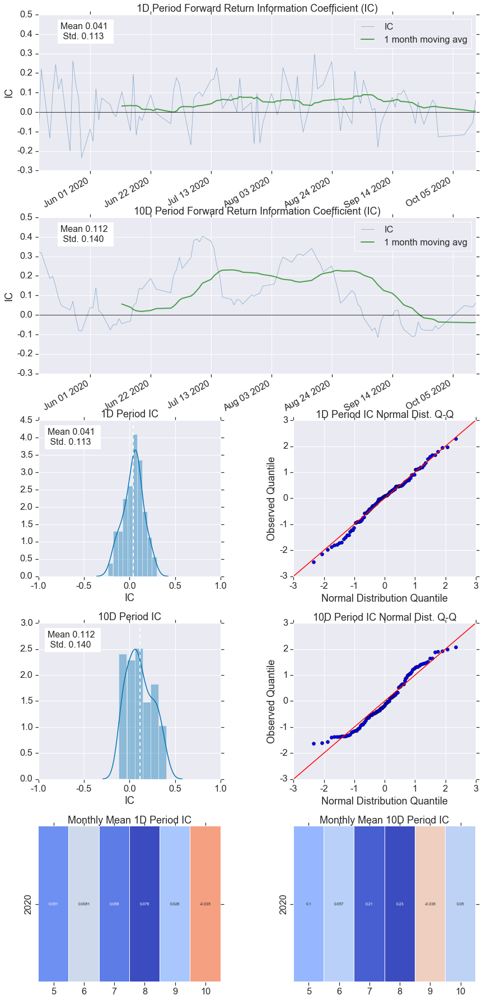

Turnover Analysis


,10D,1D
Quantile 1 Mean Turnover,0.35100000,0.06900000
Quantile 2 Mean Turnover,0.48200000,0.13200000
Quantile 3 Mean Turnover,0.58500000,0.13400000
Quantile 4 Mean Turnover,0.50600000,0.11800000
Quantile 5 Mean Turnover,0.30900000,0.05500000


,1D,10D
Mean Factor Rank Autocorrelation,0.99000000,0.81500000


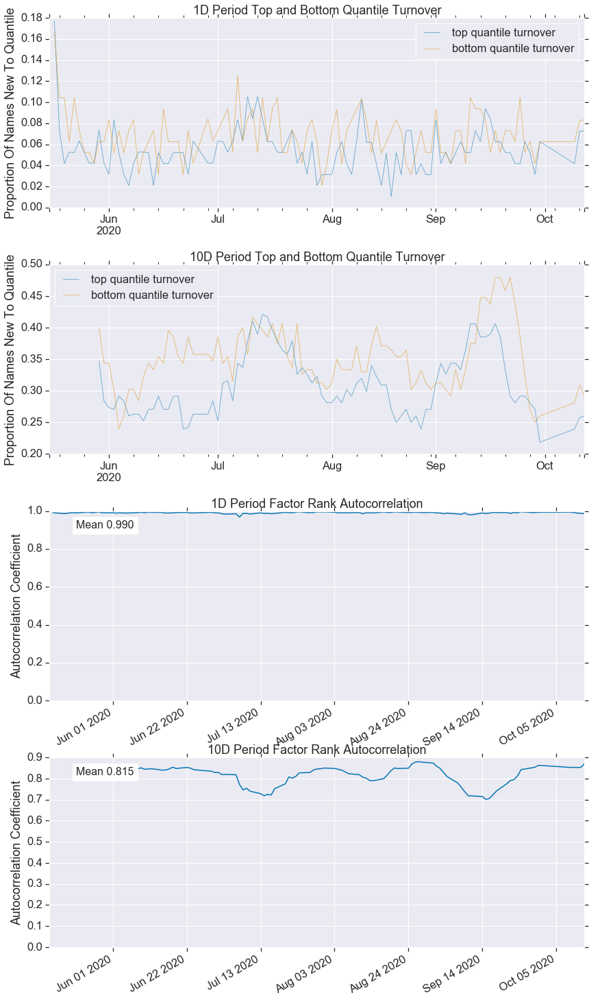

volatility_20d                           -0.02354334
Overnight_Sentiment_Smoothed              0.01911687
adv_120d                                 -0.02994764
Mean_Reversion_Sector_Neutral_Smoothed    0.00903637
adv_20d                                  -0.03950031
Momentum_1YR                             -0.01359332
增强_ALPHA                                  0.04118033
dtype: float64


In [33]:
factor_IC = show_sample_results(all_factors, X_test, clf_nov, factor_names)

So, hopefully you are appropriately amazed by this. Despite the significant differences between the factor performances in the three sets, the AI APLHA is able to deliver positive performance.